<a href="https://colab.research.google.com/github/ZequanLIU/netpyne/blob/development/connectivity_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install allensdk

In [2]:
!git clone https://github.com/AllenInstitute/aisynphys.git
!pip install ./aisynphys

fatal: destination path 'aisynphys' already exists and is not an empty directory.
Processing ./aisynphys
  Preparing metadata (setup.py) ... done
  Created wheel for aisynphys: filename=aisynphys-0.0.1-py3-none-any.whl size=351969 sha256=7f47b2867a475a328d06e03225ffdc70c0af38cbaa61c06507280ce6cc5f418f
  Stored in directory: /tmp/pip-ephem-wheel-cache-1nwn783o/wheels/ba/b2/e6/ce02b6da03f598473fe1693d089add956d2ac46854fa99c14a
Successfully built aisynphys
  Attempting uninstall: aisynphys
    Found existing installation: aisynphys 0.0.1
    Uninstalling aisynphys-0.0.1:
      Successfully uninstalled aisynphys-0.0.1


In [3]:
!git clone https://github.com/AllenInstitute/neuroanalysis.git
!pip install ./neuroanalysis

fatal: destination path 'neuroanalysis' already exists and is not an empty directory.
Processing ./neuroanalysis
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for neuroanalysis: filename=neuroanalysis-0.0.2-py3-none-any.whl size=116893 sha256=ec7f3d5a2b5ead0103e7d1327e3fc1663b3a31a3ae90a2b508e3cb87bc6eddb8
  Stored in directory: /tmp/pip-ephem-wheel-cache-fk7txk8i/wheels/4a/dd/d3/05edafc9e94651019c6aac603e4e0cc0f36c03dc04878963d8
Successfully built neuroanalysis
  Attempting uninstall: neuroanalysis
    Found existing installation: neuroanalysis 0.0.2
    Uninstalling neuroanalysis-0.0.2:
      Successfully uninstalled neuroanalysis-0.0.2


In [4]:
!git clone https://github.com/suny-downstate-medical-center/netpyne

fatal: destination path 'netpyne' already exists and is not an empty directory.


In [5]:
%cd netpyne/netpyne/tutorials/

/content/netpyne/netpyne/tutorials


In [6]:
%ls

cells/                            netpyne_tut1_traces__gid_31_.png
docs/                             netpyne_tut1_traces__gid_32_.png
install_tuts.py                   netpyne_tut1_traces__gid_33_.png
install_tuts.sh                   netpyne_tut1_traces__gid_34_.png
manifest.json                     netpyne_tut1_traces__gid_35_.png
mod/                              netpyne_tut1_traces__gid_36_.png
mouse_connectivity_matrix.svg     netpyne_tut1_traces__gid_37_.png
netpyne_tut1_traces__gid_0_.png   netpyne_tut1_traces__gid_38_.png
netpyne_tut1_traces__gid_10_.png  netpyne_tut1_traces__gid_39_.png
netpyne_tut1_traces__gid_11_.png  netpyne_tut1_traces__gid_3_.png
netpyne_tut1_traces__gid_12_.png  netpyne_tut1_traces__gid_4_.png
netpyne_tut1_traces__gid_13_.png  netpyne_tut1_traces__gid_5_.png
netpyne_tut1_traces__gid_14_.png  netpyne_tut1_traces__gid_6_.png
netpyne_tut1_traces__gid_15_.png  netpyne_tut1_traces__gid_7_.png
netpyne_tut1_traces__gid_16_.png  netpyne_tut1_traces__gid_8_.png
n

In [7]:
!pip install neuron
!pip install netpyne

# Using the Allen Institute's synaptic physiology dataset, load cell pair data for specific brain regions (e.g., murine V1 visual cortex) and examine whether synaptic connections exist between these cell pairs

In [8]:
import numpy as np
from aisynphys.database import SynphysDatabase # 用于与突触生理数据库进行交互
from aisynphys.cell_class import CellClass, classify_cells, classify_pairs # 导入用于细胞分类的类和函数
from aisynphys.connectivity import measure_connectivity, pair_was_probed

### 1. Load the data

First, load up the "small" database from release 1.0 and query all cell `pairs` for mouse projects.

In [ ]:
# Download and cache the sqlite file for the requested database
#   (for available versions, see SynphysDatabase.list_versions)
db = SynphysDatabase.load_current('small')

# Load all cell pairs associated with mouse V1 projects
mouse_pairs = db.pair_query(project_name=["mouse V1 coarse matrix", "mouse V1 pre-production"]).all()

print("loaded %d cell pairs" % len(mouse_pairs))

  /root/ai_synphys_cache/database/synphys_r2.1_small.sqlite
  [####################]  100.00% (176.77 MB / 176.8 MB)  66.736 MB/s  0:00:00 remaining
  done.
loaded 83552 cell pairs


A single cell `pair` represents a _possible_ connection from one cell to another:

In [ ]:
# print some information about the last cell pair returned
pair = mouse_pairs[-1]
print("Cell pair:", pair)
print("  presynaptic subclass:", pair.pre_cell.cre_type)
print("  postsynaptic subclass:", pair.post_cell.cre_type)
print("  synaptic connection:", "yes" if pair.has_synapse else "no")

Cell pair: <Pair 1581111499.865 8 6>
  presynaptic subclass: vip
  postsynaptic subclass: sst
  synaptic connection: no


### Criteria for defining all cell classes to be compared

In [ ]:
cell_class_criteria = {
    'l23pyr': {'dendrite_type': 'spiny',       'cortical_layer': '2/3'},
    'l23pv':  {'cre_type': 'pvalb',            'cortical_layer': '2/3'},
    'l23sst': {'cre_type': 'sst',              'cortical_layer': '2/3'},
    'l23vip': {'cre_type': 'vip',              'cortical_layer': '2/3'},
    'l4pyr':  {'cre_type': ('nr5a1', 'rorb'),  'cortical_layer': '4'},
    'l4pv':   {'cre_type': 'pvalb',            'cortical_layer': '4'},
    'l4sst':  {'cre_type': 'sst',              'cortical_layer': '4'},
    'l4vip':  {'cre_type': 'vip',              'cortical_layer': '4'},
    'l5et':   {'cre_type': ('sim1', 'fam84b'), 'cortical_layer': '5'},
    'l5it':   {'cre_type': 'tlx3',             'cortical_layer': '5'},
    'l5pv':   {'cre_type': 'pvalb',            'cortical_layer': '5'},
    'l5sst':  {'cre_type': 'sst',              'cortical_layer': '5'},
    'l5vip':  {'cre_type': 'vip',              'cortical_layer': '5'},
    'l6pyr':  {'cre_type': 'ntsr1',            'cortical_layer': ('6a','6b')},
    'l6pv':   {'cre_type': 'pvalb',            'cortical_layer': ('6a','6b')},
    'l6sst':  {'cre_type': 'sst',              'cortical_layer': ('6a','6b')},
    'l6vip':  {'cre_type': 'vip',              'cortical_layer': ('6a','6b')},
}

Create a `CellClass` object to represent each cell class described above:

In [ ]:
cell_classes = {name:CellClass(name=name, **criteria) for name,criteria in cell_class_criteria.items()}

In [ ]:
cell_classes

{'l23pyr': <CellClass l23pyr>,
 'l23pv': <CellClass l23pv>,
 'l23sst': <CellClass l23sst>,
 'l23vip': <CellClass l23vip>,
 'l4pyr': <CellClass l4pyr>,
 'l4pv': <CellClass l4pv>,
 'l4sst': <CellClass l4sst>,
 'l4vip': <CellClass l4vip>,
 'l5et': <CellClass l5et>,
 'l5it': <CellClass l5it>,
 'l5pv': <CellClass l5pv>,
 'l5sst': <CellClass l5sst>,
 'l5vip': <CellClass l5vip>,
 'l6pyr': <CellClass l6pyr>,
 'l6pv': <CellClass l6pv>,
 'l6sst': <CellClass l6sst>,
 'l6vip': <CellClass l6vip>}

### Measuring the probability of connectivity between categories

In [ ]:
# Group all cells by selected classes
cell_groups = classify_cells(cell_classes.values(), pairs=mouse_pairs)

# Group pairs into (pre_class, post_class) groups
pair_groups = classify_pairs(mouse_pairs, cell_groups)

# analyze matrix elements
results = measure_connectivity(pair_groups, sigma=100e-6, dist_measure='lateral_distance')

/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:323: RuntimeWarning: Mean of empty slice.
  mean_cp = np.exp(-x_probed**2 / (2 * sigma**2)).mean()
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:329: RuntimeWarning: invalid value encountered in long_scalars
  est_pmax = (n_conn / n_test) / mean_cp
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:323: RuntimeWarning: Mean of empty slice.
  mean_cp = np.exp(-x_probed**2 / (2 * sigma**2)).mean()
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:329: RuntimeWarning: invalid value encountered in long_scalars
  est_pmax = (n_conn / n_test) / mean_cp


All data have been loaded and connection probabilities have been calculated. For each (presynaptic_class, postsynaptic_class) combination, the resulting dictionary includes the number of hypothetical connections detected, the number of synapses found, and the probability of connection within a 95% confidence interval.

**The results for a single connection type look like:**

In [ ]:
# pick two arbitrary cell classes to display results from
pre_class = cell_classes['l23sst']
post_class = cell_classes['l23vip']

print("Connectivity results for %s => %s" % (pre_class, post_class))
print("  %d synapses found out of %d probed" % (
    results[pre_class, post_class]['n_connected'],
    results[pre_class, post_class]['n_probed'],
))
print("  %0.2f%% connection probability" % (
    results[pre_class, post_class]['connection_probability'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['connection_probability'][1] * 100,
    results[pre_class, post_class]['connection_probability'][2] * 100,
))
print("  %0.2f%% distance-adjusted connection probability" % (
    results[pre_class, post_class]['adjusted_connectivity'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['adjusted_connectivity'][1] * 100,
    results[pre_class, post_class]['adjusted_connectivity'][2] * 100,
))


Connectivity results for l23sst => l23vip
  25 synapses found out of 88 probed
  28.41% connection probability
     95% confidence interval: 19.30%-39.02%
  37.18% distance-adjusted connection probability
     95% confidence interval: 25.26%-51.07%


### 4. Display conectivity heat map

Now we want to take the entire set of results computed above (for all connection types) and display a heat map where the color represents the probability of connection.

To do this, we must first transform the results into 2D arrays of colors and labels, and then construct the heat map with a few calls to matplotlib. The function defined below

<ipython-input-20-14700ef9564b>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('plasma')


ValueError: Input values must have shape (N x 1) or (1).

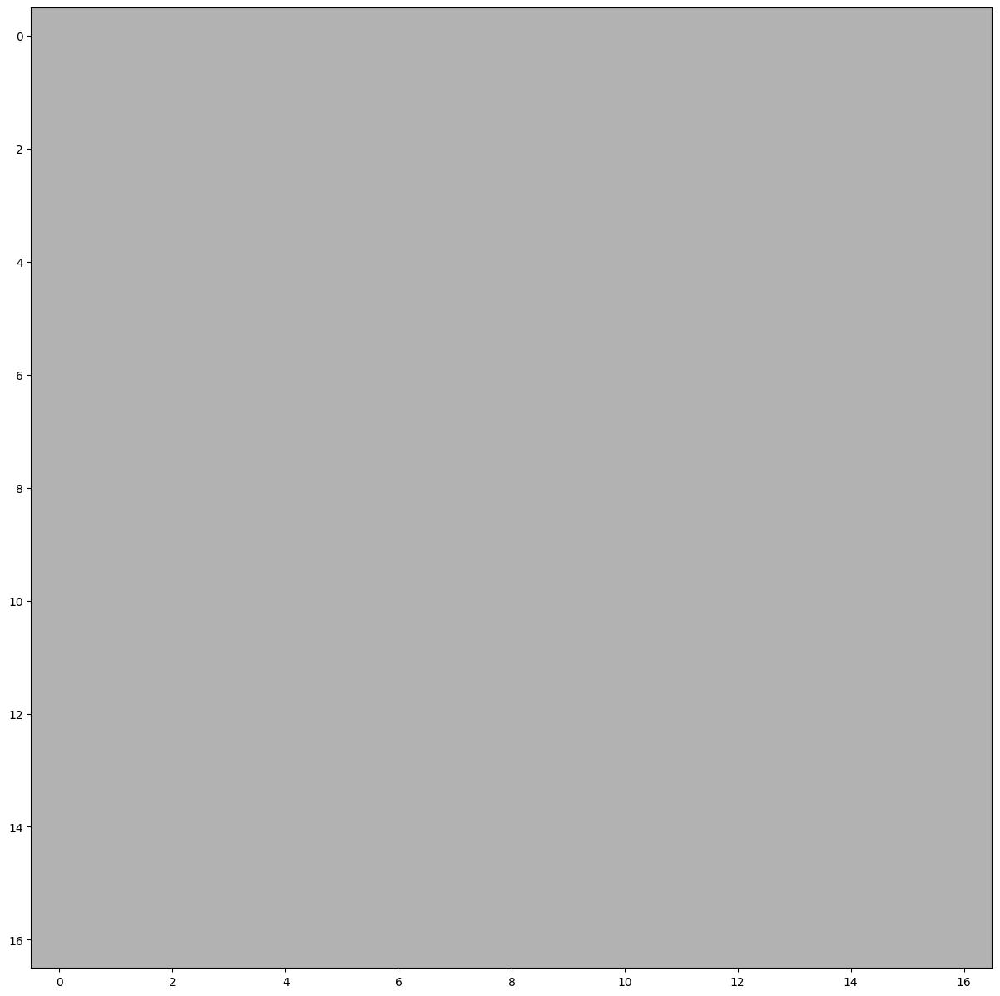

In [ ]:
import matplotlib.colors, matplotlib.cm
import matplotlib.pyplot as plt
from aisynphys.ui.notebook import show_connectivity_matrix
%matplotlib inline

# define a colormap and log normalization used to color the heatmap
norm = matplotlib.colors.LogNorm(vmin=0.01, vmax=1.0, clip=True)
cmap = matplotlib.cm.get_cmap('plasma')

# define the display labels to use for each cell subclass:
class_labels = {
    'l23pyr': 'L2/3 Pyr\nspiny',
    'l23pv':  'L2/3 Pv',
    'l23sst': 'L2/3 Sst',
    'l23vip': 'L2/3 Vip',
    'l4pyr':  'L4 Pyr\n nr5a1',
    'l4pv':   'L4 Pv',
    'l4sst':  'L4 Sst',
    'l4vip':  'L4 Vip',
    'l5et':   'L5 Pyr ET\nsim1, fam84b',
    'l5it':   'L5 Pyr IT\ntlx3',
    'l5pv':   'L5 Pv',
    'l5sst':  'L5 Sst',
    'l5vip':  'L5 Vip',
    'l6pyr':  'L6 Pyr\nntsr1',
    'l6pv':   'L6 Pv',
    'l6sst':  'L6 Sst',
    'l6vip':  'L6 Vip',
}

# create a figure/axes to draw on
fig, ax = plt.subplots(figsize=(15, 15))

# finally, draw the colormap using the provided function:
im, cbar, labels = show_connectivity_matrix(
    ax=ax,
    results=results,
    pre_cell_classes=cell_classes.values(),
    post_cell_classes=cell_classes.values(),
    class_labels=class_labels,
    cmap=cmap,
    norm=norm,
    distance_adjusted=True
)

In [ ]:
# pick two arbitrary cell classes to display results from
pre_class = cell_classes['l5vip']
post_class = cell_classes['l23vip']
#post_class = cell_classes['l4pyr']

print("Connectivity results for %s => %s" % (pre_class, post_class))
print("  %d synapses found out of %d probed" % (
    results[pre_class, post_class]['n_connected'],
    results[pre_class, post_class]['n_probed'],
))
print("  %0.2f%% connection probability" % (
    results[pre_class, post_class]['connection_probability'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['connection_probability'][1] * 100,
    results[pre_class, post_class]['connection_probability'][2] * 100,
))
print("  %0.2f%% distance-adjusted connection probability" % (
    results[pre_class, post_class]['adjusted_connectivity'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['adjusted_connectivity'][1] * 100,
    results[pre_class, post_class]['adjusted_connectivity'][2] * 100,
))
d = [p.distance for p in results[pre_class, post_class]['probed_pairs']]
print(np.mean(d))

Connectivity results for l5vip => l23vip
  0 synapses found out of 24 probed
  0.00% connection probability
     95% confidence interval: 0.00%-14.25%
  0.00% distance-adjusted connection probability
     95% confidence interval: 0.00%-23.11%
0.0002952864697432556


In [ ]:
# optionally we can save the figure at this point
fig.savefig('mouse_connectivity_matrix.svg', format='svg')

It's important to remember that the measurements of connection probability shown above come with confidence intervals -- for example, L2/3 Sst cells were interconnected 4 times out of 112 probed (3.6%), but there is a range of possible connection rates that are statistically compatible with our results:

In [ ]:
l23sst = cell_classes['l23sst']
cp, ci_low, ci_high = results[l23sst, l23sst]['connection_probability']
print(ci_low, ci_high)

0.022396996556674466 0.09854374516814673


The 95% confidence intervals above suggest that the probability of connection between L2/3 Sst cells is likely to be in the range 1-9%. Keep this statistical uncertainty in mind when interpreting the results above, and use appropriate tests when making comparisons between groups.

# use netpyne

## Neuron groups
## Layer 2/3 -> Layer 4 -> Layer 5 -> Layer 6a 6b

Easy demo: only layer 2/3

In [ ]:
from netpyne import specs, sim
import numpy as np
from allensdk.core.cell_types_cache import CellTypesCache
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_cells, classify_pairs
from aisynphys.connectivity import measure_connectivity

# Setting the cache directory
ctc = CellTypesCache(manifest_file='manifest.json')

netParams = specs.NetParams()
simConfig = specs.SimConfig()

# Creating cell type
# ------------------

netParams.cellParams['pyr'] = {}
netParams.cellParams['pyr']['secs'] = {}

# soma
netParams.cellParams['pyr']['secs']['soma'] = {}
netParams.cellParams['pyr']['secs']['soma']['geom'] = {
    "diam": 12,
    "L": 12,
    "Ra": 100.0,
    "cm": 1
}

# hh mechanism of soma
netParams.cellParams['pyr']['secs']['soma']['mechs'] = {"hh": {
    "gnabar": 0.12,
    "gkbar": 0.036,
    "gl": 0.0003,
    "el": -54.3
}}

# Creating cell populations of 100 neurons each
# ----------------------------------
populations = ['l23pyr', 'l23pv', 'l23sst', 'l23vip']
for pop in populations:
    netParams.popParams[pop] = {
        "cellType": "pyr",
        "numCells": 100,
        "yRange": [0, 300]
    }

# synapses
# ------------------------------
netParams.synMechParams['exc'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": 0
}
netParams.synMechParams['inh'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": -80
}

# Getting connection probabilities from the Allen Institute API and calculating them
# -----------------------
# Download and cache the requested sqlite file
db = SynphysDatabase.load_current('small')
mouse_pairs = db.pair_query(project_name=["mouse V1 coarse matrix", "mouse V1 pre-production"]).all()

# Defining cell class criteria
cell_class_criteria = {
    'l23pyr': {'dendrite_type': 'spiny',       'cortical_layer': '2/3'},
    'l23pv':  {'cre_type': 'pvalb',            'cortical_layer': '2/3'},
    'l23sst': {'cre_type': 'sst',              'cortical_layer': '2/3'},
    'l23vip': {'cre_type': 'vip',              'cortical_layer': '2/3'}
}

# Creating CellClass Objects
cell_classes = {name:CellClass(name=name, **criteria) for name,criteria in cell_class_criteria.items()}

# Grouping cells and cell pairs
cell_groups = classify_cells(cell_classes.values(), pairs=mouse_pairs)
pair_groups = classify_pairs(mouse_pairs, cell_groups)

# Measuring Connection Probability
results = measure_connectivity(pair_groups, sigma=100e-6, dist_measure='lateral_distance')

# Extracting and using connection probabilities
connection_probabilities = {}
for pre_class in cell_classes.values():
    for post_class in cell_classes.values():
        connection_probabilities[(pre_class.name, post_class.name)] = results[pre_class, post_class]['connection_probability'][0]

# Defining Connection Parameters
connectivity_info = []
for pre_pop in populations:
    for post_pop in populations:
        prob = connection_probabilities.get((pre_pop, post_pop), 0.1)
        synMech = "exc" if pre_pop == 'l23pyr' else "inh"
        conn_label = f'{pre_pop}->{post_pop}'
        netParams.connParams[conn_label] = {
            "preConds": {"pop": pre_pop},
            "postConds": {"pop": post_pop},
            "weight": 0.005,
            "probability": prob,
            "delay": 5.0,
            "synMech": synMech,
            "sec": "soma",
            "loc": 0.5,
        }
        connectivity_info.append(f'{conn_label} (probability: {prob:.2f}, synMech: {synMech})')

# print
for info in connectivity_info:
    print(info)

# simulation
# -----------------
netParams.stimSourceParams['bkg'] = {
    'type': 'NetStim',
    'rate': 10,  # 10 Hz
    'noise': 0.5
}

for pop in populations:
    netParams.stimTargetParams[f'bkg->{pop}'] = {
        'source': 'bkg',
        'conds': {'pop': pop},
        'weight': 0.01,
        'delay': 1,
        'sec': 'soma',
        'loc': 0.5
    }

# -----------------------------------

simConfig.filename = "netpyne_tut1"
simConfig.duration = 200.0
simConfig.dt = 0.1

# soma voltage
simConfig.recordTraces = {
    "V_soma": {
        "sec": "soma",
        "loc": 0.5,
        "var": "v",
    }
}

#
simConfig.analysis = {
    "plotTraces": {
        "include": ['all'],
        "saveFig": True,
        "overlay": True,
    },
    "plotRaster": {
        "saveFig": True,
        "marker": "o",
        "markerSize": 50,
    },
    "plotConn": {
        "saveFig": True,
        "feature": "weight",
        "groupby": "cell",
        "markerSize": 50,
    },
    "plot2Dnet": {
        "saveFig": True,
    },
}



l23pyr->l23pyr (probability: 0.06, synMech: exc)
l23pyr->l23pv (probability: 0.39, synMech: exc)
l23pyr->l23sst (probability: 0.31, synMech: exc)
l23pyr->l23vip (probability: 0.15, synMech: exc)
l23pv->l23pyr (probability: 0.32, synMech: inh)
l23pv->l23pv (probability: 0.38, synMech: inh)
l23pv->l23sst (probability: 0.10, synMech: inh)
l23pv->l23vip (probability: 0.00, synMech: inh)
l23sst->l23pyr (probability: 0.21, synMech: inh)
l23sst->l23pv (probability: 0.18, synMech: inh)
l23sst->l23sst (probability: 0.05, synMech: inh)
l23sst->l23vip (probability: 0.28, synMech: inh)
l23vip->l23pyr (probability: 0.04, synMech: inh)
l23vip->l23pv (probability: 0.02, synMech: inh)
l23vip->l23sst (probability: 0.13, synMech: inh)
l23vip->l23vip (probability: 0.01, synMech: inh)


In [ ]:
#
plt.figure()
sim.analysis.plotConn()

Plotting connectivity matrix...

There was an exception in plotConn()


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/network.py", line 818, in plotConn
    connMatrix, pre, post = _plotConnCalculateFromSim(
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/network.py", line 76, in _plotConnCalculateFromSim
    if sim.cfg.compactConnFormat:
AttributeError: module 'netpyne.sim' has no attribute 'cfg'


-1

In [ ]:
# ---------------------------------------
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)


Start time:  2024-07-02 14:11:28.713511

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.06 s.
Making connections...
  Number of connections on node 0: 26290 
  Done; cell connection time = 4.46 s.
Adding stims...
  Number of stims on node 0: 400 
  Done; cell stims creation time = 0.07 s.
Recording 400 traces of 1 types on node 0

Running simulation using NEURON for 200.0 ms...
  Done; run time = 7.04 s; real-time ratio: 0.03.

Gathering data...
  Done; gather time = 2.22 s.

Analyzing...
  Cells: 400
  Connections: 26690 (66.72 per cell)
  Spikes: 4096 (51.20 Hz)
  Simulated time: 0.2 s; 1 workers
  Run time: 7.04 s
Plotting recorded cell traces ... cell


KeyboardInterrupt: 

Preparing spike data...
Plotting raster...


<Figure size 640x480 with 0 Axes>

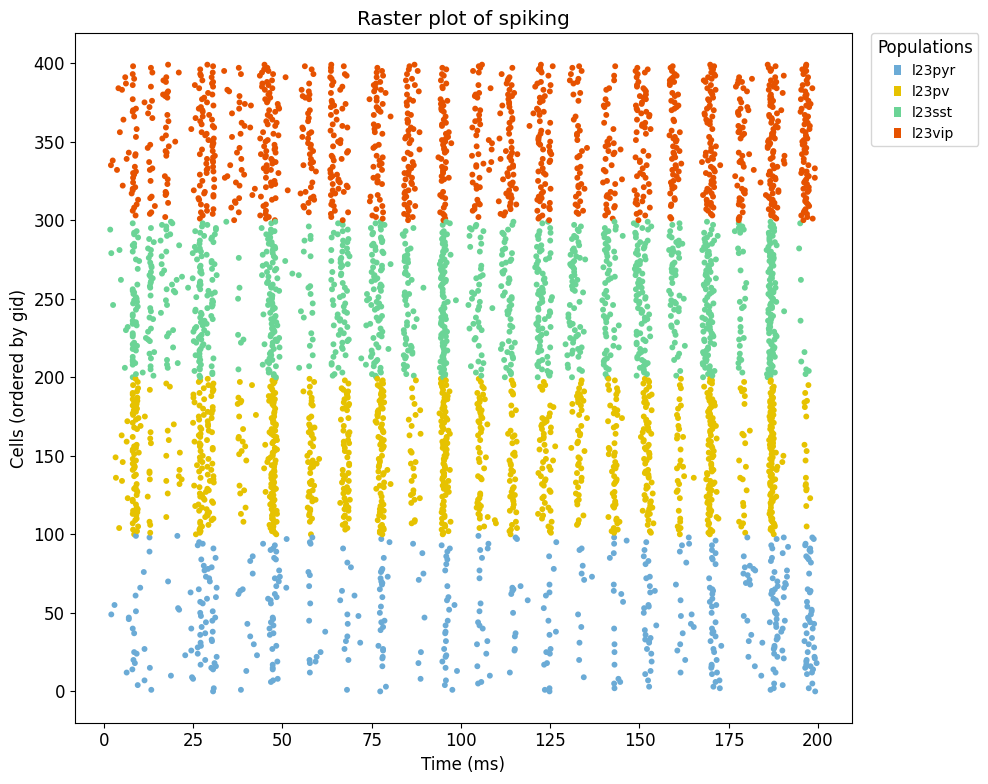

In [ ]:

if sim.allSimData['spkt']:
    plt.figure()
    sim.analysis.plotRaster(
        colors={'l23pyr': 'r', 'l23pv': 'b', 'l23sst': 'g', 'l23vip': 'm'},
        include=populations,
        marker='o',
        markerSize=10,
        showFig=True,
        saveFig=True
    )
else:
    print("No spikes recorded in the simulation.")

# Synaptic kinetics Demo

### Measuring Synaptic Short Term Plasticity

we use the [Allen Institute synaptic physiology dataset](https://portal.brain-map.org/explore/connectivity/synaptic-physiology) to measure short term plasticity and its relationship to cell subclass.


In [9]:
import numpy as np
import scipy.stats
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe

In [10]:
# Download and cache the sqlite file for the requested database
#   (for available versions, see SynphysDatabase.list_versions)
db = SynphysDatabase.load_current('small')

# Load all synapses associated with mouse multipatch experiments
pairs = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse'],
).dataframe()

print("loaded %d synapses" % len(pairs))

loaded 1805 synapses


## Classify cells

CellClass is a class object for categorizing cell types, defined in the aisynphys library. It is used to define and identify different cell subclasses based on specific classification criteria such as cre type or cell type

In [11]:
cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'), # Pvalb is commonly used as a biomarker to identify a specific type of inhibitory interneuron
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

In [12]:
# add new columns to the dataframe that apply the classification defined above
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

## Calculate average STP metric for each pre/post pairing

In [13]:
# Short-term plasticity changes induced by 50 Hz stimulation
stp = pairs.pivot_table('dynamics.stp_induction_50hz', 'pre_class', 'post_class', aggfunc=np.mean)

# sort rows/cols into the expected order
order = list(cell_classes)
stp = stp[order].loc[order]

stp

post_class,pyr,pvalb,sst,vip
pre_class,,,,
pyr,-0.336121,-0.236252,0.153188,-0.054481
pvalb,-0.498625,-0.475758,-0.347782,-0.263452
sst,-0.125576,-0.133408,-0.168907,0.288444
vip,-0.163041,-0.103669,0.045582,-0.012254


In [14]:
# Synapses between pyramidal cells are susceptible to neurotransmitter depletion in response to high-frequency stimulation
# There may be different regulatory mechanisms between SST+ neurons and VIP+ neurons that allow them to enhance synaptic responses in response to high-frequency stimulation.

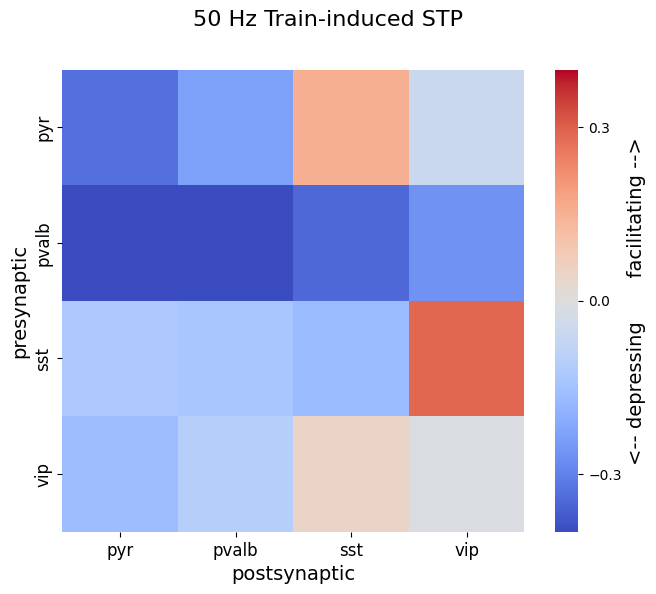

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

fig,ax = plt.subplots(figsize=(8, 6))

hm = sns.heatmap(stp, cmap='coolwarm', vmin=-0.4, vmax=0.4, square=True, ax=ax,
                cbar_kws={"ticks":[-0.3, 0, 0.3], 'label': '<-- depressing       facilitating -->'})

fig.suptitle("50 Hz Train-induced STP", fontsize=16)
hm.set_xlabel("postsynaptic", fontsize=14)
hm.set_ylabel("presynaptic", fontsize=14);
hm.figure.axes[-1].yaxis.label.set_size(14)
hm.tick_params(labelsize=12)

## Alternatively, we can calculate the average resting state variance for each pairing
Synaptic variability between different cell types.
Resting-state variance reflects the variability of synaptic activity in the resting state, i.e., the stability or fluctuation of neuronal activity when unstimulated.

In [16]:
var = pairs.pivot_table('dynamics.variability_resting_state', 'pre_class', 'post_class', aggfunc=np.mean)

# sort rows/cols into the expected order
order = list(cell_classes)
var = var[order].loc[order]

var

post_class,pyr,pvalb,sst,vip
pre_class,,,,
pyr,-0.339417,0.490162,1.822031,1.548100
pvalb,-0.833936,-0.919017,-0.719812,-0.142069
sst,-0.230243,-0.159587,0.125349,0.076180
vip,0.539063,0.579907,0.502864,0.271833


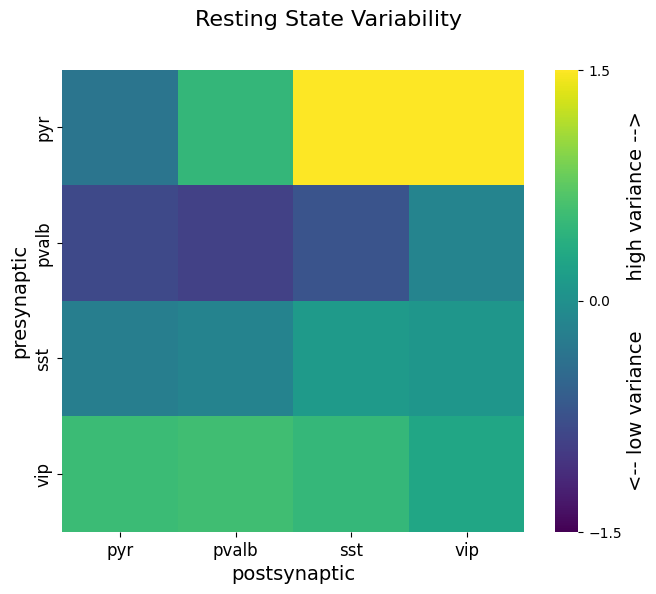

In [17]:
fig,ax = plt.subplots(figsize=(8, 6))

hm = sns.heatmap(var, cmap='viridis', vmin=-1.5, vmax=1.5, square=True, ax=ax,
                cbar_kws={"ticks":[-1.5, 0, 1.5], 'label': '<-- low variance        high variance -->'})

fig.suptitle("Resting State Variability", fontsize=16)
hm.set_xlabel("postsynaptic", fontsize=14)
hm.set_ylabel("presynaptic", fontsize=14);
hm.figure.axes[-1].yaxis.label.set_size(14)
hm.tick_params(labelsize=12)

## Extract multiple synaptic properties and plot as matrices

Plotting synaptic properties among cell sublcasses in matrices like these is common enough that we have provided a convenince function to do just that called `cell_class_matrix`

AttributeError: 'OptionEngine' object has no attribute 'execute'

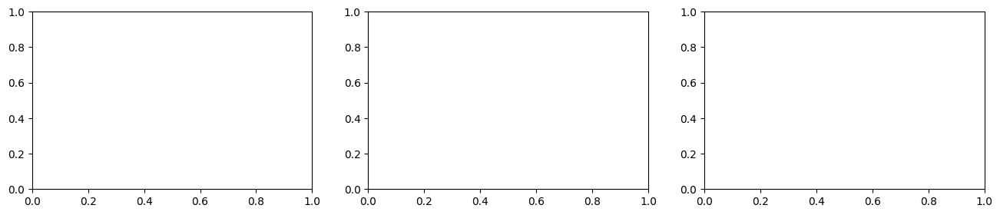

In [18]:
from aisynphys.ui.notebook import cell_class_matrix

fig,ax = plt.subplots(1, 3, figsize=(16, 3))

metrics = ['stp_induction_50hz', 'stp_recovery_250ms', 'variability_resting_state']

for i, metric in enumerate(metrics):
    cell_class_matrix(
        pre_classes=cell_classes,
        post_classes=cell_classes,
        metric=metric,
        class_labels=None, ax=ax[i],
        db=db, pair_query_args={
            'experiment_type': 'standard multipatch',
            'synapse': True,
            'species': 'mouse',
        }
    );

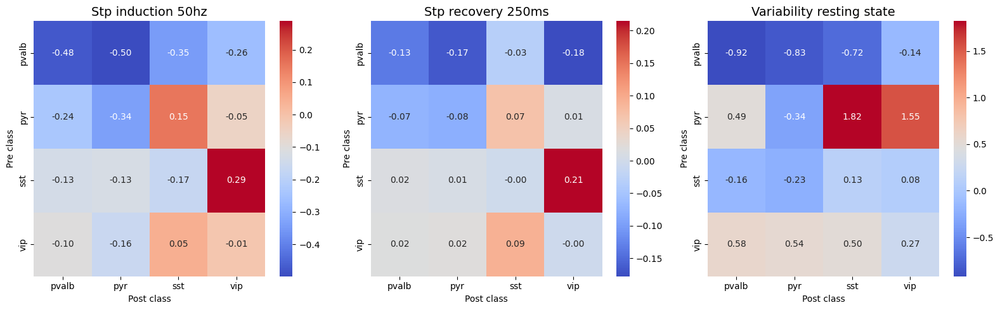

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe

%matplotlib inline

db = SynphysDatabase.load_current('small')

cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'),
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

# 查询并加载所有突触对
pairs_query = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse']
)
pairs = pairs_query.dataframe()

# 对细胞对进行分类
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

# 提取多个突触特性
metrics = ['dynamics.stp_induction_50hz', 'dynamics.stp_recovery_250ms', 'dynamics.variability_resting_state']

# 创建绘图
fig, ax = plt.subplots(1, 3, figsize=(16, 5))

for i, metric in enumerate(metrics):
    # 创建数据透视表
    data_pivot = pairs.pivot_table(values=metric, index='pre_class', columns='post_class', aggfunc=np.mean)

    # 绘制热图
    sns.heatmap(data_pivot, cmap='coolwarm', ax=ax[i], annot=True, fmt=".2f")
    ax[i].set_title(metric.replace('dynamics.', '').replace('_', ' ').capitalize(), fontsize=14)
    ax[i].set_xlabel('Post class')
    ax[i].set_ylabel('Pre class')

plt.tight_layout()
plt.show()



Start time:  2024-07-02 14:41:11.174560

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.16 s.
Making connections...
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding plasticity using STP mechanism
Error: exception when adding pla

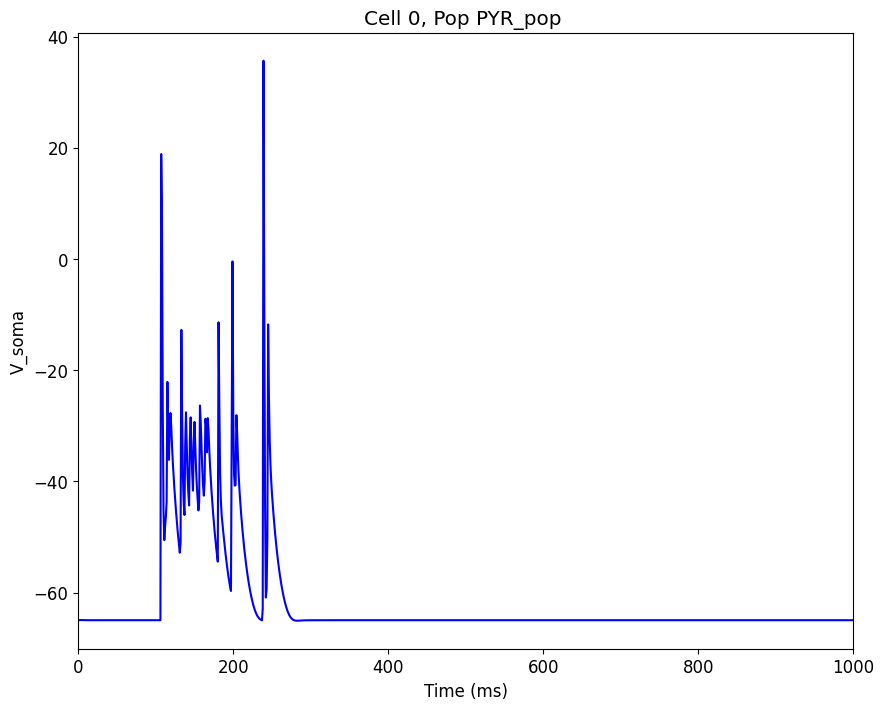

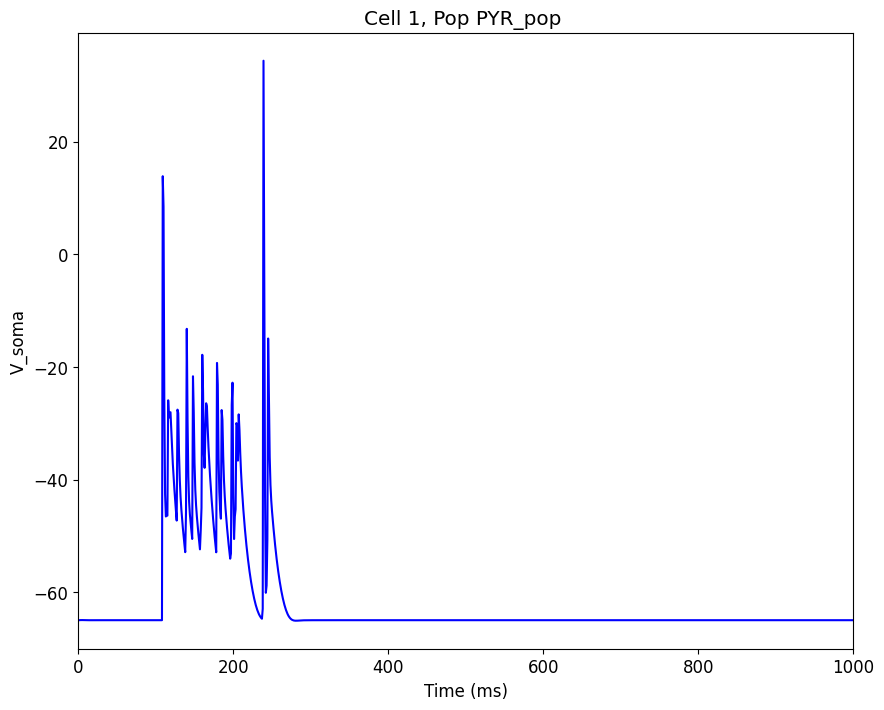

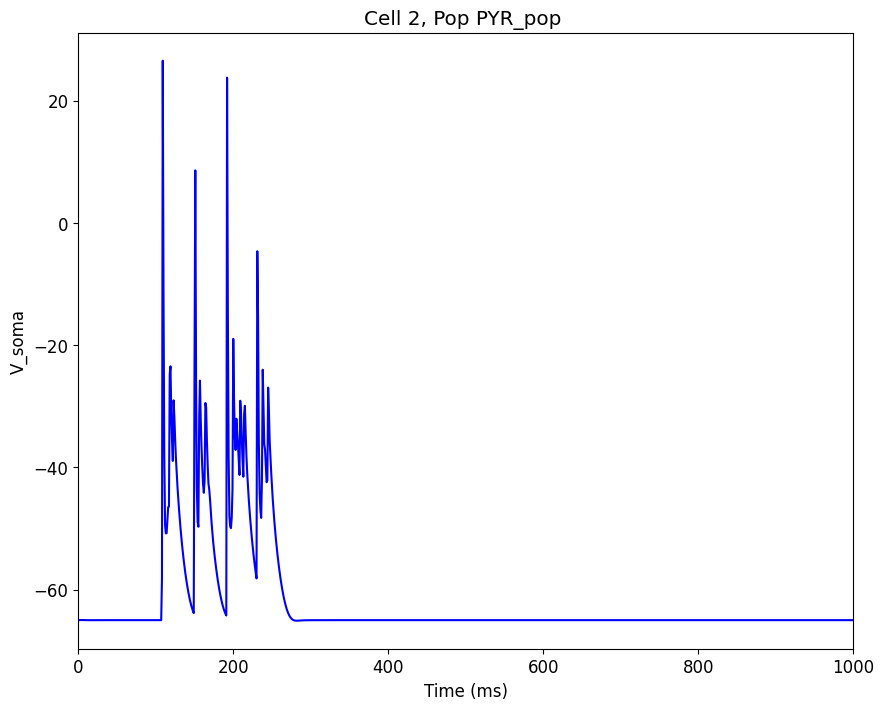

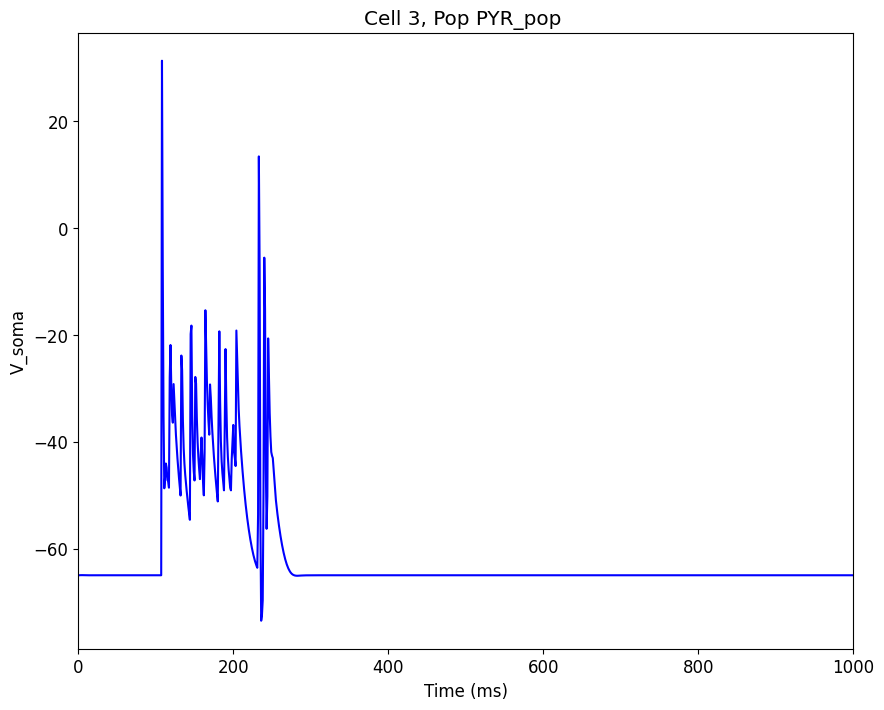

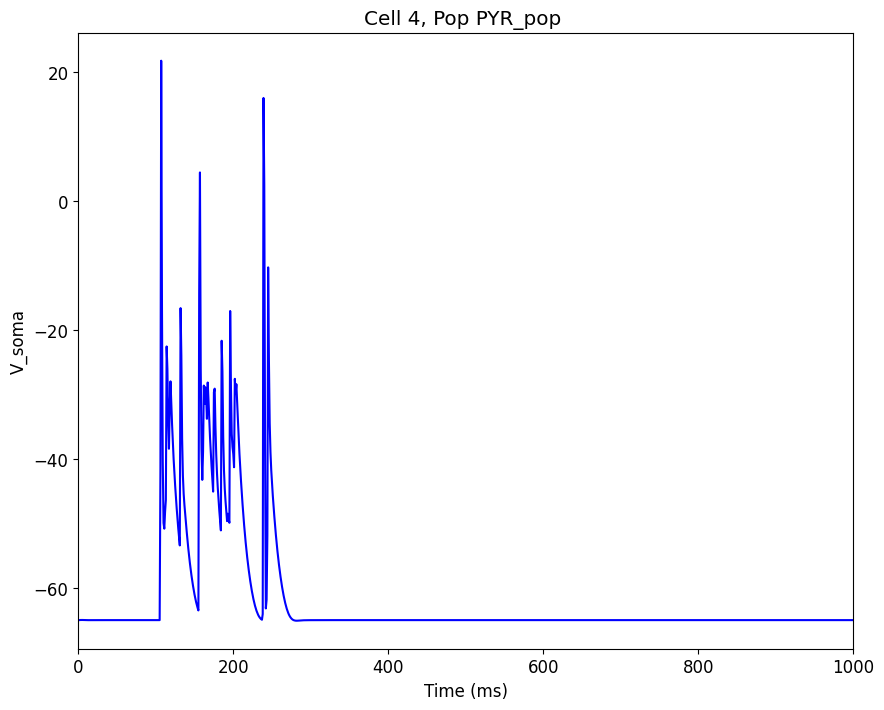

...

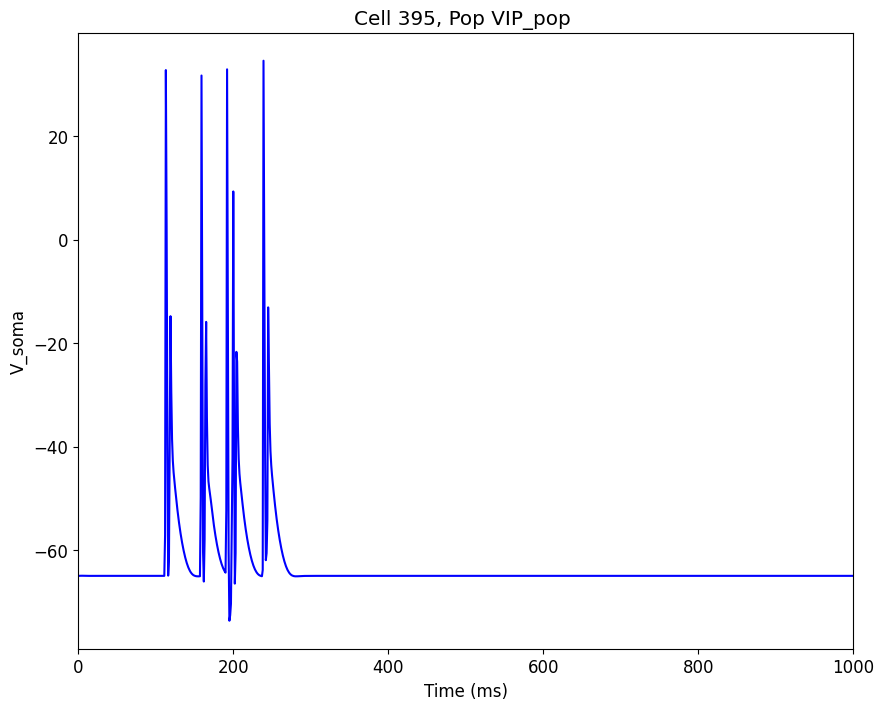

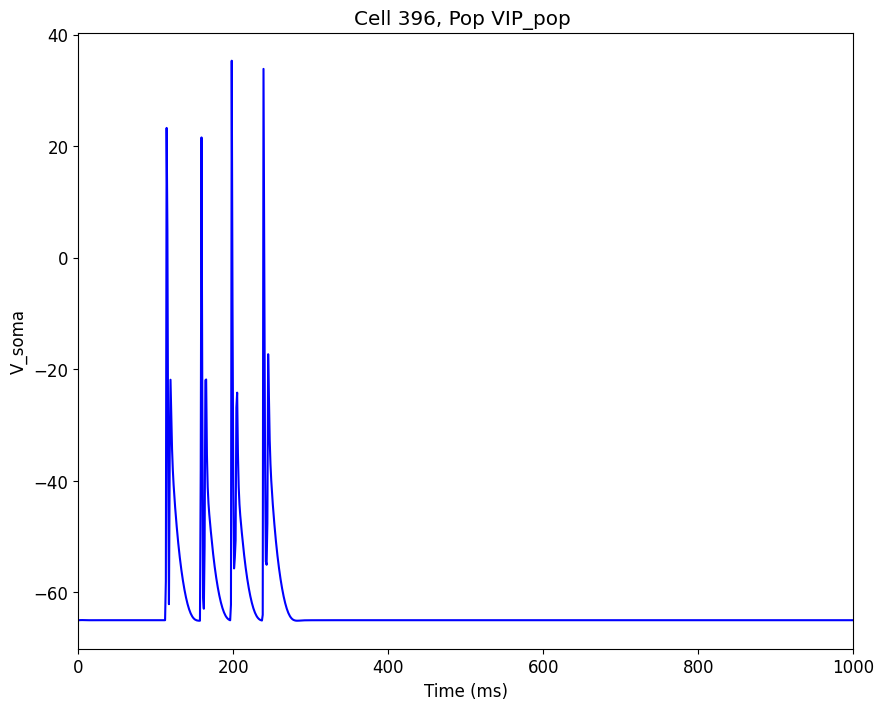

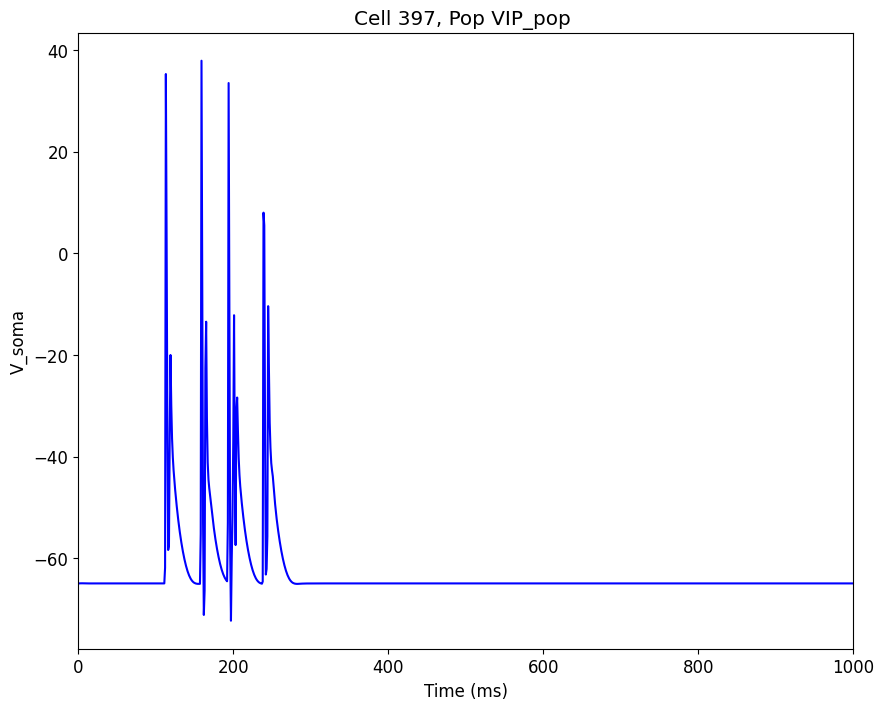

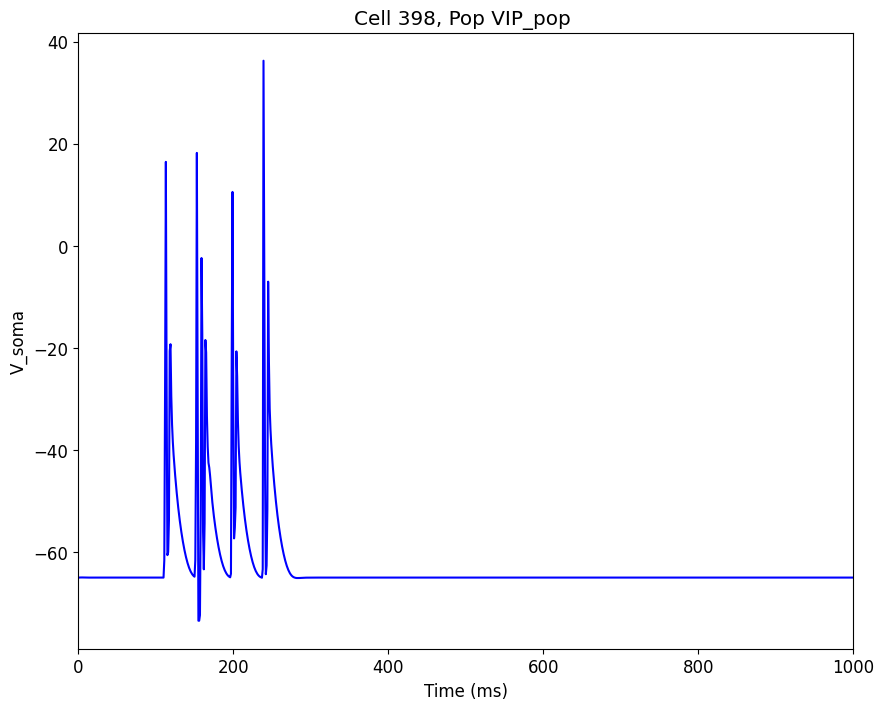

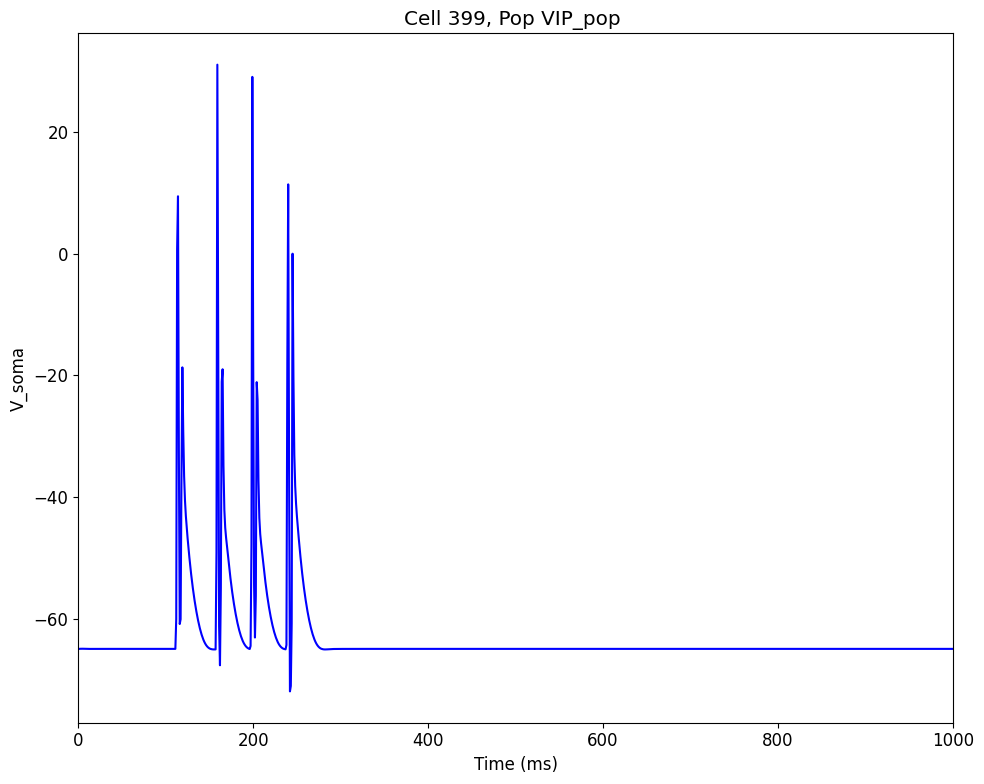

  Done; plotting time = 145.38 s

Total time = 220.07 s


In [29]:
from netpyne import specs, sim

# 创建网络参数
netParams = specs.NetParams()

# 定义细胞类型参数
cell_rule = {
    'secs': {
        'soma': {
            'geom': {'diam': 20, 'L': 20, 'Ra': 150},
            'mechs': {'hh': {}}
        }
    }
}

netParams.cellParams['PYR'] = cell_rule
netParams.cellParams['PVALB'] = cell_rule
netParams.cellParams['SST'] = cell_rule
netParams.cellParams['VIP'] = cell_rule

# 定义人口参数
netParams.popParams['PYR_pop'] = {'cellType': 'PYR', 'numCells': 100}
netParams.popParams['PVALB_pop'] = {'cellType': 'PVALB', 'numCells': 100}
netParams.popParams['SST_pop'] = {'cellType': 'SST', 'numCells': 100}
netParams.popParams['VIP_pop'] = {'cellType': 'VIP', 'numCells': 100}

# 定义突触机制参数
netParams.synMechParams['exc'] = {'mod': 'Exp2Syn', 'tau1': 0.5, 'tau2': 5.0, 'e': 0}
netParams.synMechParams['inh'] = {'mod': 'Exp2Syn', 'tau1': 1.0, 'tau2': 20.0, 'e': -80}

# 短期可塑性数据
stp_data = {
    'pyr': {'pyr': -0.336, 'pvalb': -0.236, 'sst': 0.153, 'vip': -0.054},
    'pvalb': {'pyr': -0.499, 'pvalb': -0.476, 'sst': -0.348, 'vip': -0.263},
    'sst': {'pyr': -0.126, 'pvalb': -0.133, 'sst': -0.169, 'vip': 0.288},
    'vip': {'pyr': -0.163, 'pvalb': -0.104, 'sst': 0.046, 'vip': -0.012},
}

# 定义连接规则并应用 STP 数据
for pre, post_data in stp_data.items():
    for post, stp_value in post_data.items():
        conn_rule = {
            'preConds': {'pop': f'{pre.upper()}_pop'},
            'postConds': {'pop': f'{post.upper()}_pop'},
            'probability': 0.1,
            'weight': 0.005,
            'delay': 5,
            'synMech': 'exc'
        }

        # 简化版的STP实现，用于示例
        if stp_value > 0:
            conn_rule['plast'] = {
                'mech': 'STP',
                'params': {'U': 0.5, 'tau_facil': 100.0, 'tau_rec': 800.0, 'stp_value': stp_value}
            }

        netParams.connParams[f'{pre.upper()}->{post.upper()}'] = conn_rule

# 添加外部刺激
stim_params = {
    'pop': 'PYR_pop',
    'sec': 'soma',
    'loc': 0.5,
    'synMech': 'exc',
    'start': 100,
    'interval': 10,
    'noise': 0.5,
    'number': 10
}

netParams.stimSourceParams['stim'] = {'type': 'NetStim', **stim_params}
netParams.stimTargetParams['stim->PYR'] = {'source': 'stim', 'conds': {'pop': 'PYR_pop'}, 'weight': 0.1, 'delay': 5, 'synMech': 'exc'}

# 定义仿真配置
simConfig = specs.SimConfig()
simConfig.duration = 1000  # 仿真时间 (毫秒)
simConfig.dt = 0.025  # 仿真时间步长 (毫秒)
simConfig.recordTraces = {'V_soma': {'sec': 'soma', 'loc': 0.5, 'var': 'v'}}
simConfig.recordStep = 1  # 记录每步
simConfig.filename = 'model_output'  # 仿真输出文件
simConfig.saveJson = True  # 保存为JSON文件
simConfig.analysis['plotRaster'] = {'saveFig': True}  # 栅格图
simConfig.analysis['plotTraces'] = {'include': ['all']}  # 电压轨迹

# 运行仿真
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)


loaded 1805 synapses

Start time:  2024-07-02 14:45:20.472591

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.05 s.
Making connections...
  Number of connections on node 0: 4872 
  Done; cell connection time = 2.03 s.
Adding stims...
  Number of stims on node 0: 400 
  Done; cell stims creation time = 0.10 s.
Recording 400 traces of 1 types on node 0

Running simulation using NEURON for 200.0 ms...
  Done; run time = 1.51 s; real-time ratio: 0.13.

Gathering data...
  Done; gather time = 0.23 s.

Analyzing...
  Cells: 400
  Connections: 5272 (13.18 per cell)
  Spikes: 1983 (24.79 Hz)
  Simulated time: 0.2 s; 1 workers
  Run time: 1.51 s
Plotting recorded cell traces ... cell


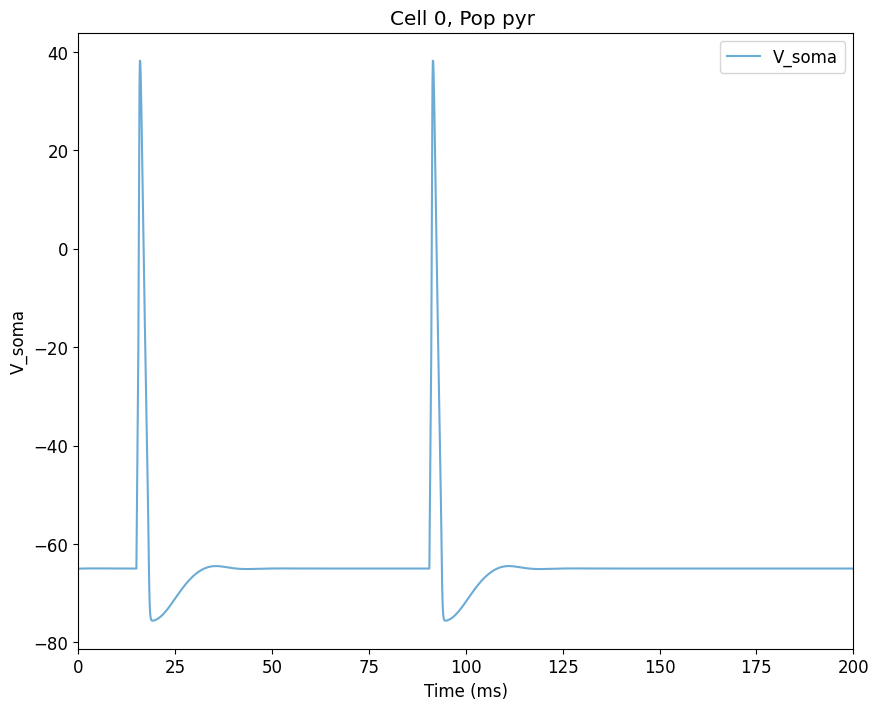

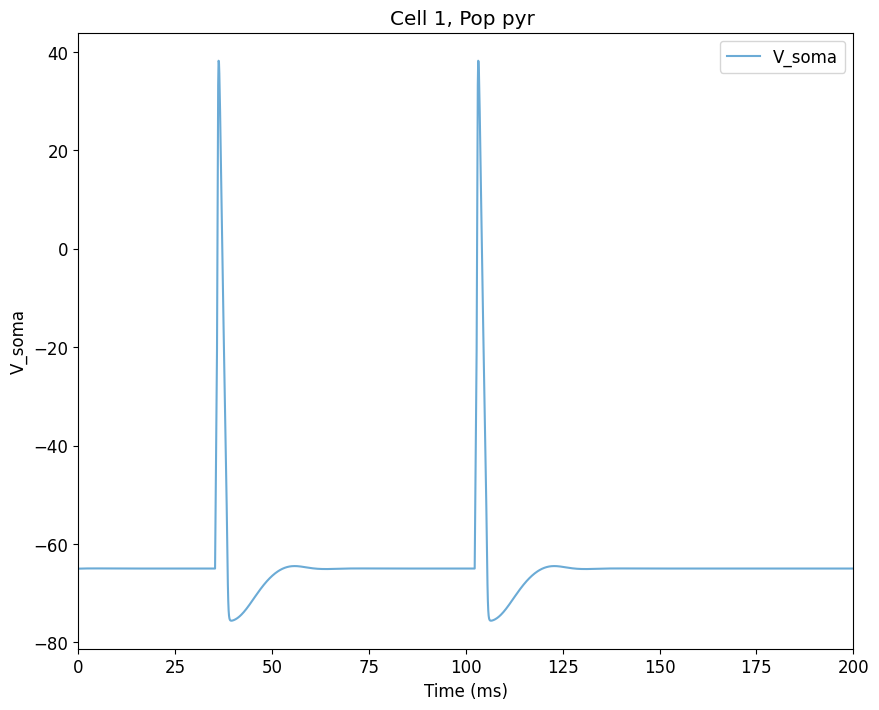

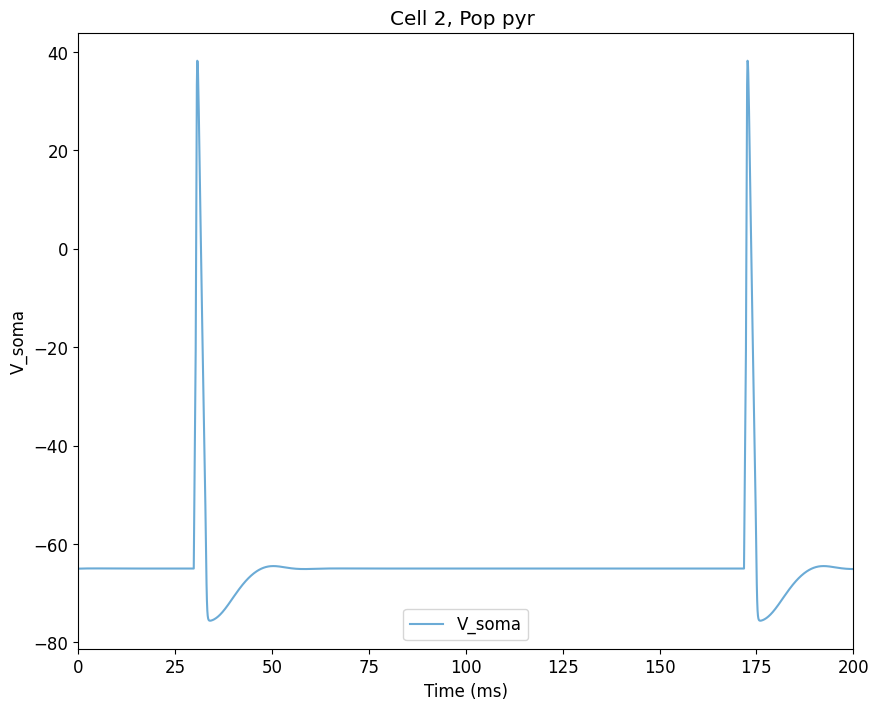

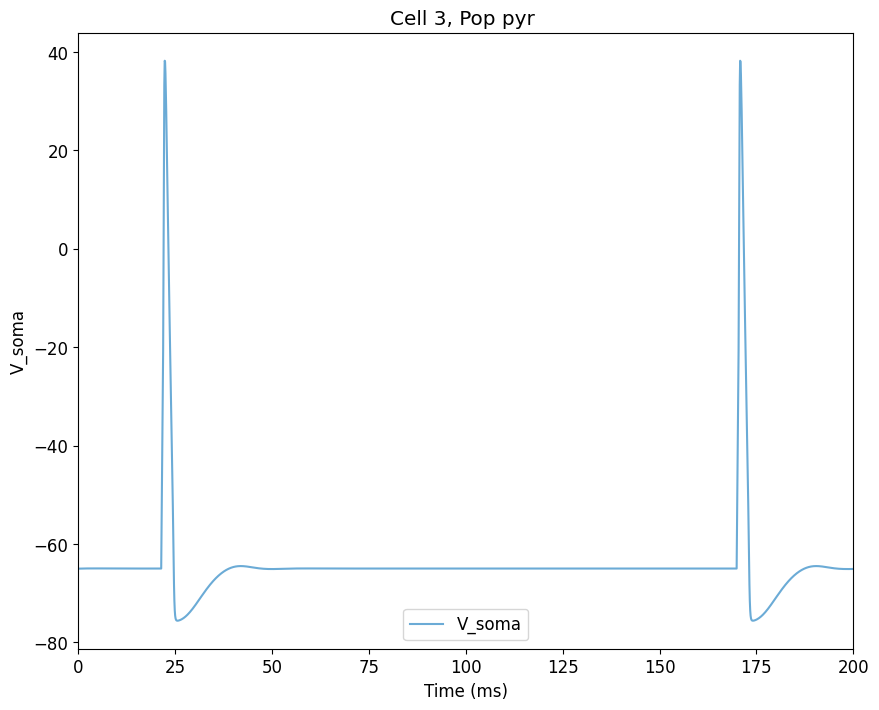

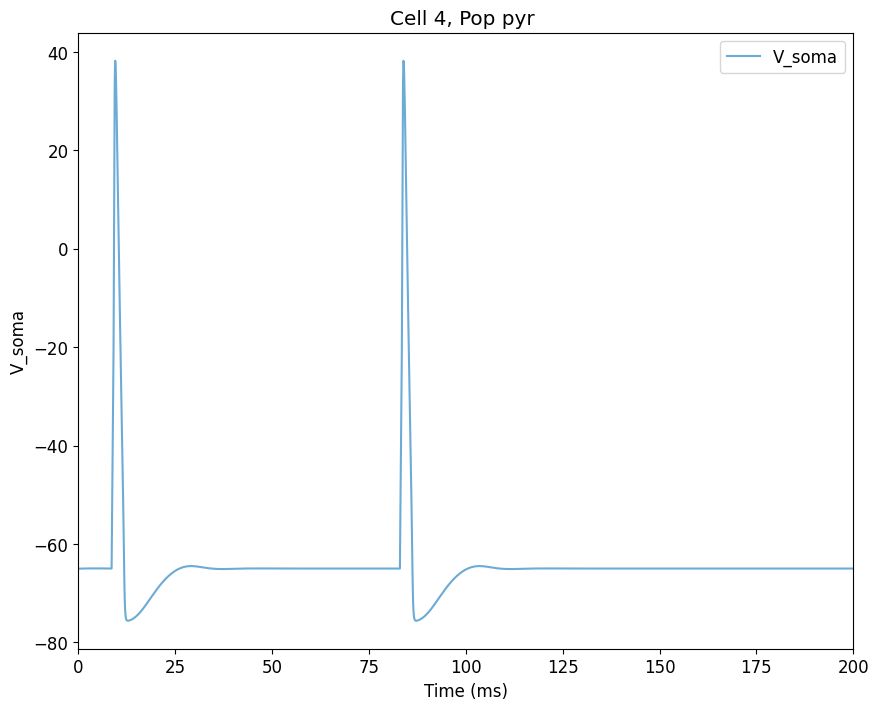

...

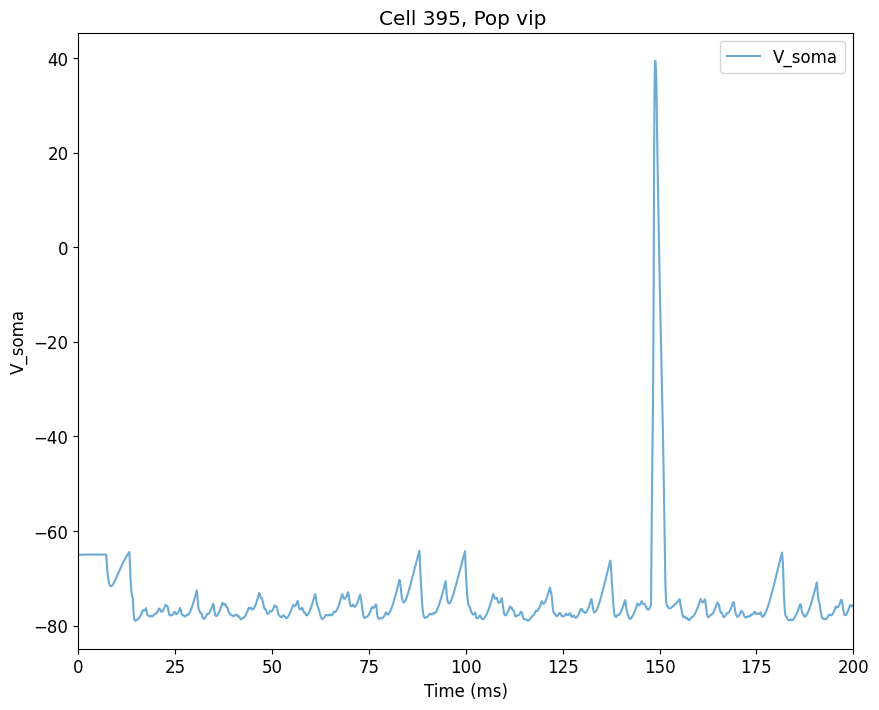

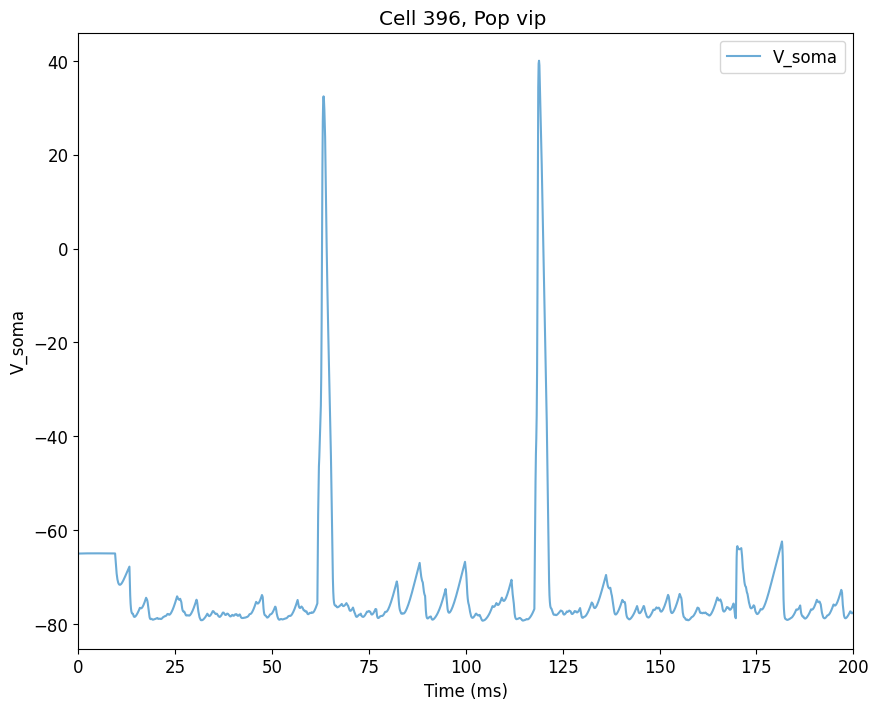

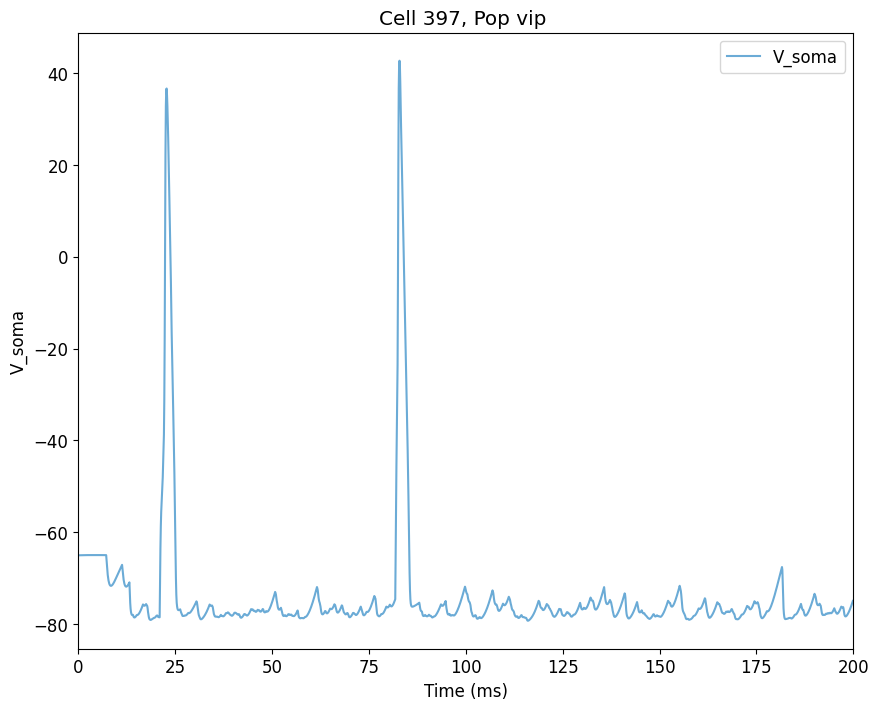

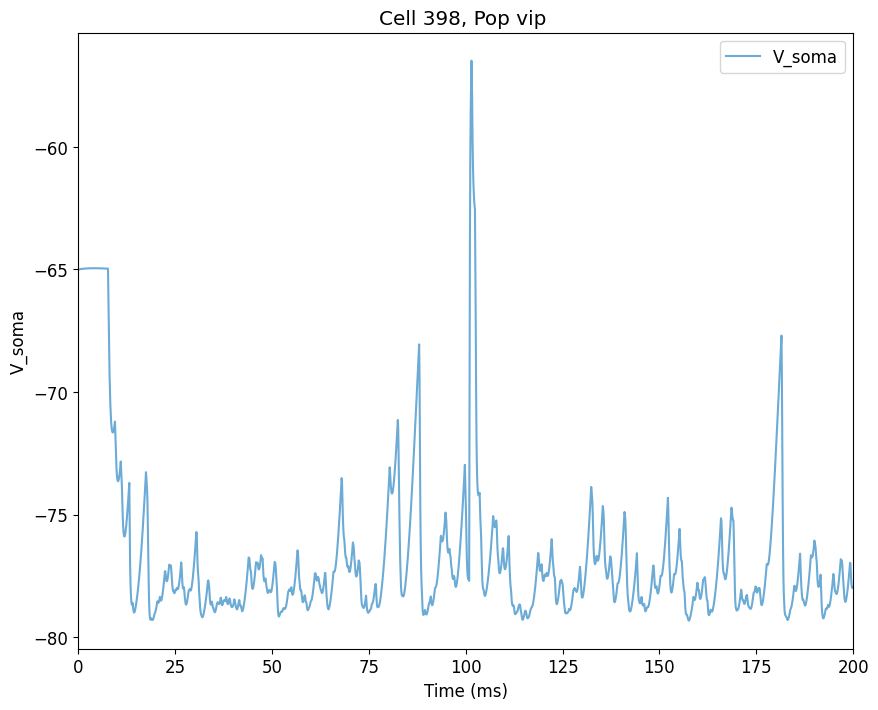

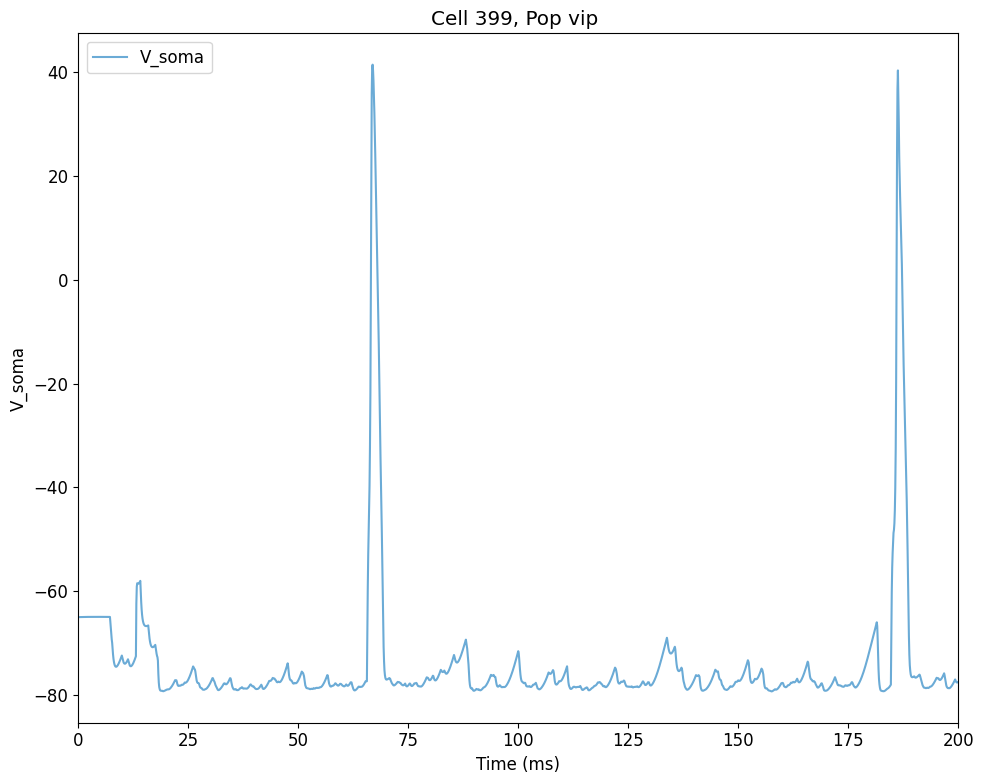

Preparing spike data...
Plotting raster...

There was an exception in plotConn()
  Done; plotting time = 243.19 s

Total time = 247.18 s
Preparing spike data...
Plotting raster...


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'



There was an exception in plotConn()


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'


-1

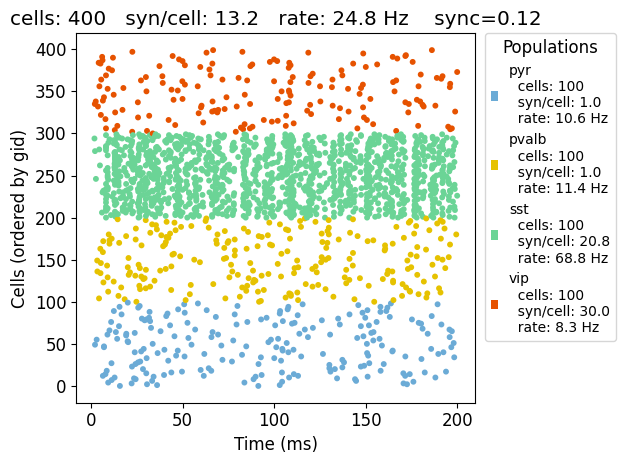

<Figure size 640x480 with 0 Axes>

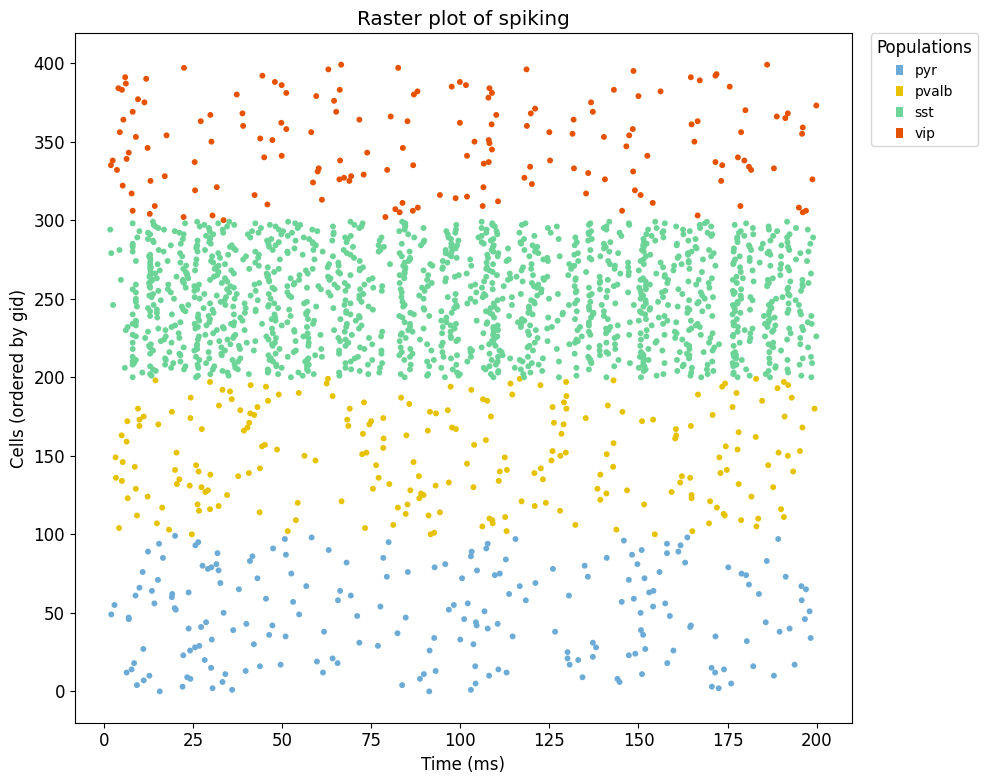

<Figure size 640x480 with 0 Axes>

In [30]:
# Step 1: Import required libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from netpyne import specs, sim
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe
from aisynphys.connectivity import measure_connectivity

# 保证图像内联显示
%matplotlib inline

# Step 2: Load and process the STP data from Allen Institute API

# Download and cache the sqlite file for the requested database
db = SynphysDatabase.load_current('small')

# Load all synapses associated with mouse multipatch experiments
pairs = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse'],
).dataframe()

print("loaded %d synapses" % len(pairs))

# Define cell classes
cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'),
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

# Classify cells
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

# Short-term plasticity changes induced by 50 Hz stimulation
stp = pairs.pivot_table('dynamics.stp_induction_50hz', 'pre_class', 'post_class', aggfunc=np.mean)

# Sort rows/cols into the expected order
order = list(cell_classes)
stp = stp[order].loc[order]

# Step 3: Define NetPyNE network parameters and simulation configuration
netParams = specs.NetParams()
simConfig = specs.SimConfig()

# Define cell properties
netParams.cellParams['pyr'] = {
    'secs': {
        'soma': {
            'geom': {
                'diam': 12,
                'L': 12,
                'Ra': 100.0,
                'cm': 1
            },
            'mechs': {
                'hh': {
                    'gnabar': 0.12,
                    'gkbar': 0.036,
                    'gl': 0.0003,
                    'el': -54.3
                }
            }
        }
    }
}

# Create populations
populations = ['pyr', 'pvalb', 'sst', 'vip']
for pop in populations:
    netParams.popParams[pop] = {
        "cellType": "pyr",
        "numCells": 100,
        "yRange": [0, 300]
    }

# Define synaptic mechanisms
netParams.synMechParams['exc'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": 0
}
netParams.synMechParams['inh'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": -80
}

# Define connectivity using STP data
for pre_pop in populations:
    for post_pop in populations:
        prob = stp.at[pre_pop, post_pop] if not np.isnan(stp.at[pre_pop, post_pop]) else 0.1
        synMech = "exc" if pre_pop == 'pyr' else "inh"
        conn_label = f'{pre_pop}->{post_pop}'
        netParams.connParams[conn_label] = {
            "preConds": {"pop": pre_pop},
            "postConds": {"pop": post_pop},
            "weight": 0.005,
            "probability": prob,
            "delay": 5.0,
            "synMech": synMech,
            "sec": "soma",
            "loc": 0.5,
        }

# Add background stimulation
netParams.stimSourceParams['bkg'] = {
    'type': 'NetStim',
    'rate': 10,
    'noise': 0.5
}
for pop in populations:
    netParams.stimTargetParams[f'bkg->{pop}'] = {
        'source': 'bkg',
        'conds': {'pop': pop},
        'weight': 0.01,
        'delay': 1,
        'sec': 'soma',
        'loc': 0.5
    }

# Set up simulation configuration
simConfig.filename = "netpyne_tut_stp"
simConfig.duration = 200.0
simConfig.dt = 0.1

# Record from all cells
simConfig.recordTraces = {
    "V_soma": {
        "sec": "soma",
        "loc": 0.5,
        "var": "v",
    }
}

# Plot configurations
simConfig.analysis = {
    "plotTraces": {
        "include": ['all'],
        "saveFig": True,
        "overlay": True,
    },
    "plotRaster": {
        "include": populations,
        "saveFig": True,
        "marker": "o",
        "markerSize": 10,
        "showFig": True
    },
    "plotConn": {
        "feature": "probability",
        "groupBy": "pop",
        "include": populations,
        "saveFig": True,
        "showFig": True
    }
}

# Create, simulate, and analyze the model
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)

# Plotting the raster plot and connectivity matrix
plt.figure()
sim.analysis.plotRaster(
    colors={'pyr': 'r', 'pvalb': 'b', 'sst': 'g', 'vip': 'm'},
    include=populations,
    marker='o',
    markerSize=10,
    showFig=True,
    saveFig=True
)

plt.figure()
sim.analysis.plotConn(
    feature='probability',
    groupBy='pop',
    include=populations,
    showFig=True,
    saveFig=True
)


refine simulation

loaded 1805 synapses

Start time:  2024-07-02 14:51:01.335429

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.08 s.
Making connections...
  Number of connections on node 0: 4872 
  Done; cell connection time = 1.94 s.
Adding stims...
  Number of stims on node 0: 400 
  Done; cell stims creation time = 0.06 s.
Recording 400 traces of 1 types on node 0

Running simulation using NEURON for 200.0 ms...
  Done; run time = 1.04 s; real-time ratio: 0.19.

Gathering data...
  Done; gather time = 0.26 s.

Analyzing...
  Cells: 400
  Connections: 5272 (13.18 per cell)
  Spikes: 1983 (24.79 Hz)
  Simulated time: 0.2 s; 1 workers
  Run time: 1.04 s
Preparing spike data...
Plotting raster...

There was an exception in plotConn()
  Done; plotting time = 0.47 s

Total time = 3.89 s
Preparing spike data...
Plotting raster...


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'



There was an exception in plotConn()


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'


-1

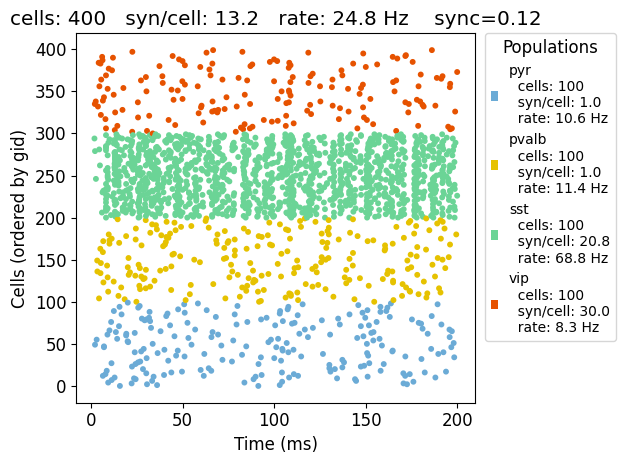

<Figure size 640x480 with 0 Axes>

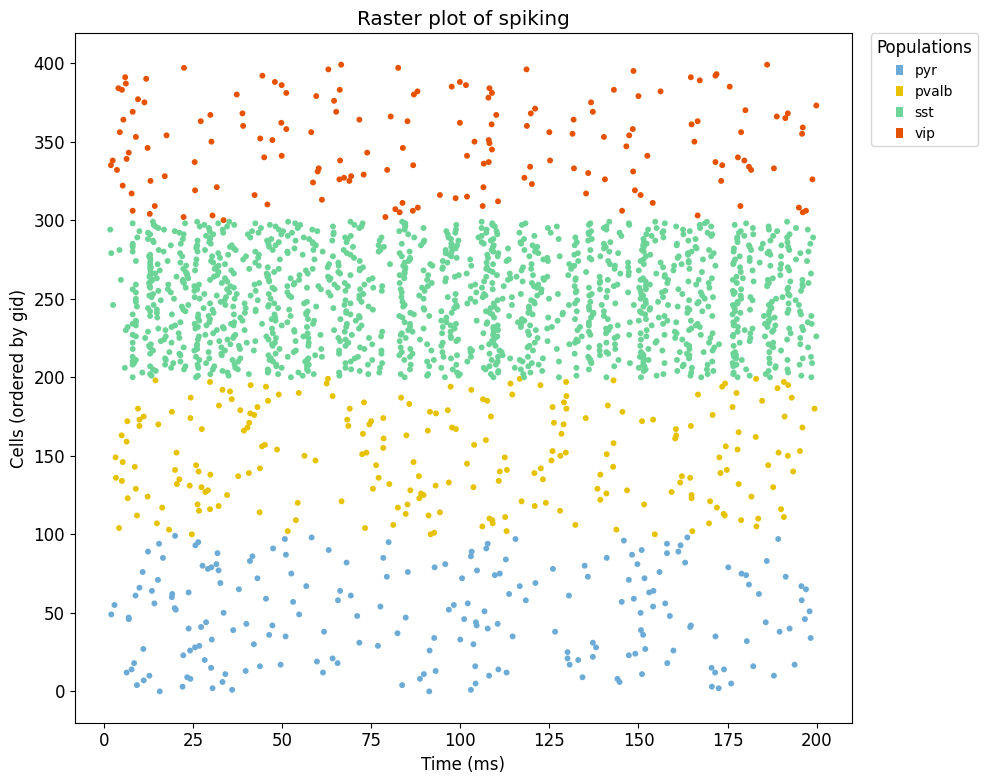

<Figure size 640x480 with 0 Axes>

In [31]:
# Step 1: Import required libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from netpyne import specs, sim
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe
from aisynphys.connectivity import measure_connectivity

# 保证图像内联显示
%matplotlib inline

# Step 2: Load and process the STP data from Allen Institute API

# Download and cache the sqlite file for the requested database
db = SynphysDatabase.load_current('small')

# Load all synapses associated with mouse multipatch experiments
pairs = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse'],
).dataframe()

print("loaded %d synapses" % len(pairs))

# Define cell classes
cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'),
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

# Classify cells
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

# Short-term plasticity changes induced by 50 Hz stimulation
stp = pairs.pivot_table('dynamics.stp_induction_50hz', 'pre_class', 'post_class', aggfunc=np.mean)

# Sort rows/cols into the expected order
order = list(cell_classes)
stp = stp[order].loc[order]

# Step 3: Define NetPyNE network parameters and simulation configuration
netParams = specs.NetParams()
simConfig = specs.SimConfig()

# Define cell properties
netParams.cellParams['pyr'] = {
    'secs': {
        'soma': {
            'geom': {
                'diam': 12,
                'L': 12,
                'Ra': 100.0,
                'cm': 1
            },
            'mechs': {
                'hh': {
                    'gnabar': 0.12,
                    'gkbar': 0.036,
                    'gl': 0.0003,
                    'el': -54.3
                }
            }
        }
    }
}

# Create populations
populations = ['pyr', 'pvalb', 'sst', 'vip']
for pop in populations:
    netParams.popParams[pop] = {
        "cellType": "pyr",
        "numCells": 100,
        "yRange": [0, 300]
    }

# Define synaptic mechanisms
netParams.synMechParams['exc'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": 0
}
netParams.synMechParams['inh'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": -80
}

# Define connectivity using STP data
for pre_pop in populations:
    for post_pop in populations:
        prob = stp.at[pre_pop, post_pop] if not np.isnan(stp.at[pre_pop, post_pop]) else 0.1
        synMech = "exc" if pre_pop == 'pyr' else "inh"
        conn_label = f'{pre_pop}->{post_pop}'
        netParams.connParams[conn_label] = {
            "preConds": {"pop": pre_pop},
            "postConds": {"pop": post_pop},
            "weight": 0.005,
            "probability": prob,
            "delay": 5.0,
            "synMech": synMech,
            "sec": "soma",
            "loc": 0.5,
        }

# Add background stimulation
netParams.stimSourceParams['bkg'] = {
    'type': 'NetStim',
    'rate': 10,
    'noise': 0.5
}
for pop in populations:
    netParams.stimTargetParams[f'bkg->{pop}'] = {
        'source': 'bkg',
        'conds': {'pop': pop},
        'weight': 0.01,
        'delay': 1,
        'sec': 'soma',
        'loc': 0.5
    }

# Set up simulation configuration
simConfig.filename = "netpyne_tut_stp"
simConfig.duration = 200.0
simConfig.dt = 0.1

# Record from all cells
simConfig.recordCells = ['all']
simConfig.recordTraces = {
    "V_soma": {
        "sec": "soma",
        "loc": 0.5,
        "var": "v",
    }
}

# Plot configurations
simConfig.analysis = {
    "plotRaster": {
        "include": populations,
        "saveFig": True,
        "marker": "o",
        "markerSize": 10,
        "showFig": True
    },
    "plotConn": {
        "feature": "probability",
        "groupBy": "pop",
        "include": populations,
        "saveFig": True,
        "showFig": True
    }
}

# Create, simulate, and analyze the model
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)

# Plotting the raster plot and connectivity matrix
plt.figure()
sim.analysis.plotRaster(
    colors={'pyr': 'r', 'pvalb': 'b', 'sst': 'g', 'vip': 'm'},
    include=populations,
    marker='o',
    markerSize=10,
    showFig=True,
    saveFig=True
)

plt.figure()
sim.analysis.plotConn(
    feature='probability',
    groupBy='pop',
    include=populations,
    showFig=True,
    saveFig=True
)


### Measuring Synaptic Kinetics



we use the [Allen Institute synaptic physiology dataset](https://portal.brain-map.org/explore/connectivity/synaptic-physiology) to measure the kinetic properties of synaptic connections and the relationship to cell subclass.



In [32]:
import numpy as np
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass

We are going to compare the strength of excitatory connectivity onto the three inhibitory cell subclassess -- Pvalb, Sst, and Vip.

Begin by defining these subclasses:

In [33]:
post_classes = {
    'pvalb': CellClass(cre_type='pvalb'),
    'sst': CellClass(cre_type='sst'),
    'vip': CellClass(cre_type='vip'),
}

Query the database to get all excitatory synapses with a specific postsynaptic cre type. We also filter here for "standard multipatch" experiment types in order to exclude other experiment types as well as filter for "mouse" as the species.

In [34]:
# query once for each postsynaptic type, building up a Pandas dataframe

pairs = None
for name, post_class in post_classes.items():
    pair_query = db.pair_query(
        experiment_type='standard multipatch',
        species='mouse',
        post_class=post_class,
        synapse=True,
        synapse_type='ex',
    )
    pair_query = pair_query.add_columns(
        db.Synapse.latency,
        db.Synapse.psc_rise_time,
        db.Synapse.psc_decay_tau,
        db.Synapse.psp_amplitude,
    )
    df = pair_query.dataframe()
    df['post_class'] = name
    if pairs is None:
        pairs = df
    else:
        pairs = pairs.append(df)
    print("%s: %d synapses" % (name, len(df)))

pvalb: 146 synapses
sst: 118 synapses
vip: 30 synapses


In [35]:
# we now have all synapses loaded into one dataframe:
pairs.head()

,pair.id,pair.experiment_id,pair.pre_cell_id,pair.post_cell_id,pair.has_synapse,pair.has_polysynapse,pair.has_electrical,pair.crosstalk_artifact,pair.n_ex_test_spikes,pair.n_in_test_spikes,pair.distance,pair.lateral_distance,pair.vertical_distance,pair.reciprocal_id,pair.meta,synapse.latency,synapse.psc_rise_time,synapse.psc_decay_tau,synapse.psp_amplitude,post_class
0,56292,1658,9817,9814,True,False,False,NaN,480,60,0.000063,0.000055,0.000017,56260,None,0.001414,0.001245,0.001667,0.000027,pvalb
1,56277,1658,9816,9814,True,False,False,NaN,480,60,0.000059,0.000038,0.000036,56259,None,0.001213,0.000936,0.001386,0.001267,pvalb
2,56208,1656,9804,9806,True,False,False,NaN,877,120,0.000154,0.000007,0.000137,56221,None,0.001921,0.002889,0.003035,0.000079,pvalb
3,76481,2337,13628,13627,True,False,False,NaN,408,60,0.000120,0.000093,0.000038,76475,None,0.004030,0.001870,0.002411,NaN,pvalb
4,63795,1889,11179,11177,True,False,False,NaN,168,36,0.000038,0.000023,0.000027,63788,None,0.000742,0.000948,0.004091,0.000263,pvalb


ValueError: cannot reindex on an axis with duplicate labels

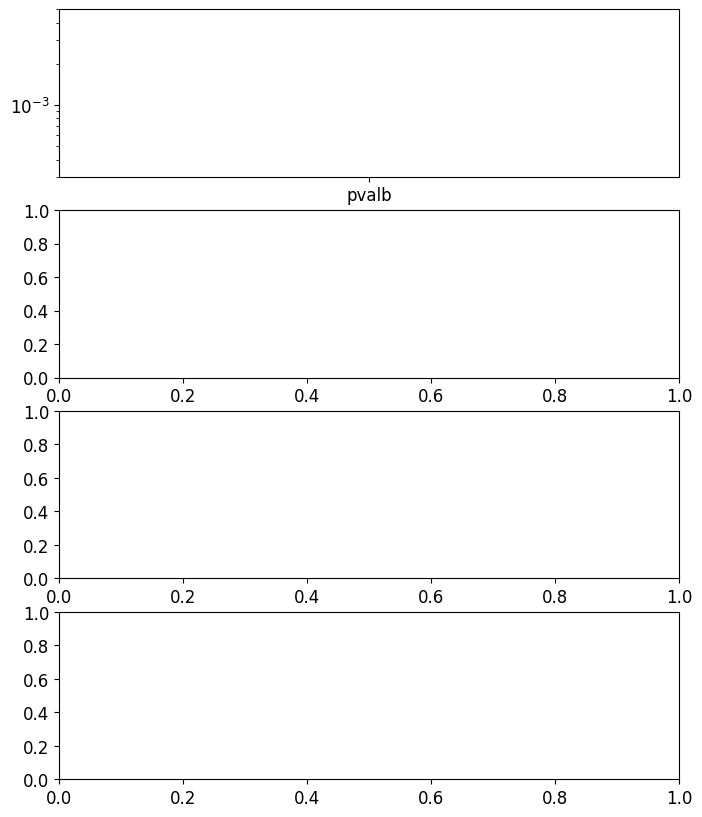

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

limits = {
    'latency': (0.3e-3, 5e-3),
    'psc_rise_time': (0.3e-3, 5e-3),
    'psc_decay_tau': (0.3e-3, 15e-3),
    'psp_amplitude': (10e-6, 5e-3),
}
units = ['ms', 'ms', 'ms', 'mV']
ticks = {
    'ms': 0.5e-3 * 2**np.arange(4),
    'mV': 20e-6 * 4**np.arange(4),
}

fig,ax = plt.subplots(len(limits), 1, figsize=(8, 2.5 * len(limits)))


for i, (field, lim) in enumerate(limits.items()):
    # box and swarm plots
    ax[i].set_yscale('log')
    ax[i].set_ylim(*lim)
    sns.boxplot(x="post_class", y="synapse."+field, data=pairs, ax=ax[i], palette='pastel', width=0.8, linewidth=1)
    sns.swarmplot(x="post_class", y="synapse."+field, data=pairs, ax=ax[i], size=5, color=(0, 0, 0, 0.5))

    # clean up labels / ticks
    if i == len(limits)-1:
        ax[i].set_xlabel('postsynaptic class', size=14)
    else:
        ax[i].set_xlabel('')
    ax[i].set_ylabel(field.replace('_', ' ') + ' (%s)'%units[i], size=12)
    ax[i].set_yticks(ticks[units[i]])
    ax[i].set_yticklabels(['%0.2f' % (x*1000) for x in ticks[units[i]]])
    ax[i].set_yticklabels([], minor=True)


In [ ]:
fig,ax = plt.subplots()

x_field = 'psc_rise_time'
y_field = 'psc_decay_tau'
ax.set_xlim(limits[x_field])
ax.set_ylim(limits[y_field])
ax.set_yscale('log')
ax.set_xscale('log')

sns.scatterplot(
    x="synapse."+x_field,
    y="synapse."+y_field,
    hue="post_class",
    size="synapse.psp_amplitude",
    data=pairs,
    ax=ax,
)
ax.legend(loc="upper right", bbox_to_anchor=(1.5, 1))

use netpyne

In [37]:
import numpy as np
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe
import matplotlib.pyplot as plt
import seaborn as sns

# 下载并缓存所需数据库
db = SynphysDatabase.load_current('small')

# 定义细胞类型
cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'),
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

# 加载所有突触到一个数据框中
pairs = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse'],
).dataframe()

# 分类细胞对
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

# 计算每对细胞的平均STP指标
stp = pairs.pivot_table('dynamics.stp_induction_50hz', 'pre_class', 'post_class', aggfunc=np.mean)

# 排序行和列
order = list(cell_classes)
stp = stp[order].loc[order]



Start time:  2024-07-02 14:56:50.440373

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.05 s.
Making connections...
  Number of connections on node 0: 15956 
  Done; cell connection time = 2.88 s.
Adding stims...
  Number of stims on node 0: 400 
  Done; cell stims creation time = 0.06 s.
Recording 400 traces of 1 types on node 0

Running simulation using NEURON for 200.0 ms...
  Done; run time = 2.45 s; real-time ratio: 0.08.

Gathering data...
  Done; gather time = 0.61 s.

Analyzing...
  Cells: 400
  Connections: 16356 (40.89 per cell)
  Spikes: 3750 (46.88 Hz)
  Simulated time: 0.2 s; 1 workers
  Run time: 2.45 s
Preparing spike data...
Plotting raster...

There was an exception in plotConn()
  Done; plotting time = 0.60 s

Total time = 6.71 s
Preparing spike data...
Plotting raster...


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'



There was an exception in plotConn()


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'include'


-1

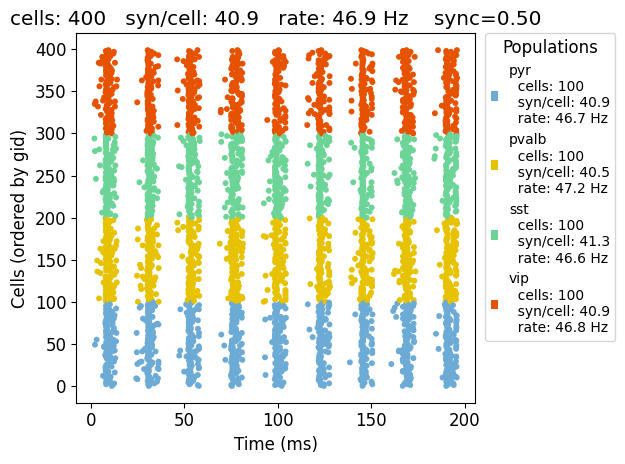

<Figure size 640x480 with 0 Axes>

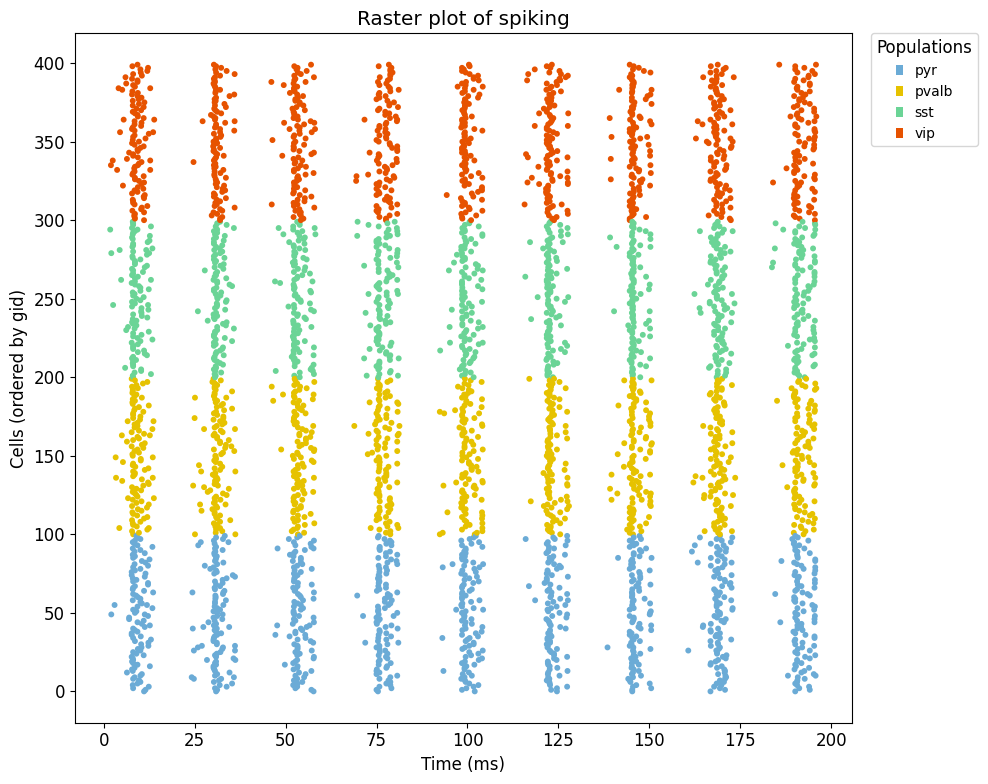

<Figure size 640x480 with 0 Axes>

In [38]:
from netpyne import specs, sim

netParams = specs.NetParams()
simConfig = specs.SimConfig()

# 定义细胞类型
netParams.cellParams['pyr'] = {
    'secs': {
        'soma': {
            'geom': {
                'diam': 12,
                'L': 12,
                'Ra': 100.0,
                'cm': 1
            },
            'mechs': {
                'hh': {
                    'gnabar': 0.12,
                    'gkbar': 0.036,
                    'gl': 0.0003,
                    'el': -54.3
                }
            }
        }
    }
}

# 创建细胞群体
populations = ['pyr', 'pvalb', 'sst', 'vip']
for pop in populations:
    netParams.popParams[pop] = {
        "cellType": "pyr",
        "numCells": 100,
        "yRange": [0, 300]
    }

# 定义突触机制
netParams.synMechParams['exc'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": 0
}

# 使用STP数据定义连接参数
for pre_pop in populations:
    for post_pop in populations:
        stp_value = stp.loc[pre_pop, post_pop]
        conn_label = f'{pre_pop}->{post_pop}'
        netParams.connParams[conn_label] = {
            "preConds": {"pop": pre_pop},
            "postConds": {"pop": post_pop},
            "weight": 0.005,  # 使用一个固定的基础权重
            "probability": 0.1,  # 你可以使用STP数据调整权重或概率
            "delay": 5.0,
            "synMech": "exc",
            "sec": "soma",
            "loc": 0.5,
        }

# 添加背景刺激
netParams.stimSourceParams['bkg'] = {
    'type': 'NetStim',
    'rate': 10,
    'noise': 0.5
}
for pop in populations:
    netParams.stimTargetParams[f'bkg->{pop}'] = {
        'source': 'bkg',
        'conds': {'pop': pop},
        'weight': 0.01,
        'delay': 1,
        'sec': 'soma',
        'loc': 0.5
    }

# 设置模拟配置
simConfig.filename = "netpyne_tut_stp"
simConfig.duration = 200.0
simConfig.dt = 0.1

# 记录所有细胞
simConfig.recordCells = ['all']
simConfig.recordTraces = {
    "V_soma": {
        "sec": "soma",
        "loc": 0.5,
        "var": "v",
    }
}

# 绘图配置
simConfig.analysis = {
    "plotRaster": {
        "include": populations,
        "saveFig": True,
        "marker": "o",
        "markerSize": 10,
        "showFig": True
    },
    "plotConn": {
        "feature": "probability",
        "groupBy": "pop",
        "include": populations,
        "saveFig": True,
        "showFig": True
    }
}

# 创建、模拟并分析模型
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)

# 绘制放电栅图和连接矩阵
plt.figure()
sim.analysis.plotRaster(
    colors={'pyr': 'r', 'pvalb': 'b', 'sst': 'g', 'vip': 'm'},
    include=populations,
    marker='o',
    markerSize=10,
    showFig=True,
    saveFig=True
)

plt.figure()
sim.analysis.plotConn(
    feature='probability',
    groupBy='pop',
    include=populations,
    showFig=True,
    saveFig=True
)
